In [1]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("requiemonk/sentinel12-image-pairs-segregated-by-terrain")

print("Path to dataset files:", path)

100%|██████████| 2.55G/2.55G [02:01<00:00, 22.6MB/s]

Extracting files...


Path to dataset files: /root/.cache/kagglehub/datasets/requiemonk/sentinel12-image-pairs-segregated-by-terrain/versions/1


In [2]:
import os

directory = "/root/.cache/kagglehub/datasets/requiemonk/sentinel12-image-pairs-segregated-by-terrain/versions/1/v_2"
files = os.listdir(directory)

for file in files:
    print(file)

agri
urban
grassland
barrenland


In [3]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms
from torchvision import models
import numpy as np
from tqdm import tqdm
import os
from PIL import Image
import random

In [ ]:

torch.manual_seed(42)
random.seed(42)
np.random.seed(42)


class SARColorizationDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        self.transform = transform
        self.image_pairs = self._load_image_pairs()

    def _load_image_pairs(self):
        image_pairs = []
        land_types = ["agri", "barrenland", "grassland", "urban"]

        for land in land_types:
            sar_dir = os.path.join(self.root_dir, land, "s1")
            optical_dir = os.path.join(self.root_dir, land, "s2")


            if not os.path.exists(sar_dir) or not os.path.exists(optical_dir):
                print(f"Skipping {land} because directories are missing.")
                continue


            sar_files = [f for f in os.listdir(sar_dir) if "_s1_" in f]
            optical_files = [f for f in os.listdir(optical_dir) if "_s2_" in f]

            sar_base = {f.replace("_s1_", ""): f for f in sar_files}
            optical_base = {f.replace("_s2_", ""): f for f in optical_files}


            common_basenames = set(sar_base.keys()).intersection(set(optical_base.keys()))

            for base in common_basenames:
                sar_path = os.path.join(sar_dir, sar_base[base])
                optical_path = os.path.join(optical_dir, optical_base[base])
                image_pairs.append((sar_path, optical_path))

        return image_pairs

    def __len__(self):
        return len(self.image_pairs)

    def __getitem__(self, idx):
        sar_path, optical_path = self.image_pairs[idx]
        sar_image = Image.open(sar_path).convert("L")  # Convert to grayscale
        optical_image = Image.open(optical_path).convert("RGB")  # Convert to RGB

        if self.transform:
            sar_image = self.transform(sar_image)
            optical_image = self.transform(optical_image)

        return sar_image, optical_image

#Transforms
transform = transforms.Compose([
    transforms.Resize((256, 256)),  # Resize images to 256x256
    transforms.ToTensor(),  # Convert to tensor
    transforms.Normalize(mean=[0.5], std=[0.5])  # Normalize to [-1, 1]
])

In [ ]:
from torch.utils.data import random_split
dataset = SARColorizationDataset(root_dir="/root/.cache/kagglehub/datasets/requiemonk/sentinel12-image-pairs-segregated-by-terrain/versions/1/v_2", transform=transform)
train_size = int(0.9 * len(dataset))  
test_size = len(dataset) - train_size  

train_dataset, test_dataset = random_split(dataset, [train_size, test_size])

#sizes of the splits
print(f"Training dataset size: {len(train_dataset)}")
print(f"Testing dataset size: {len(test_dataset)}")
#DataLoaders for train and test sets
train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True, num_workers=2)
test_loader = DataLoader(test_dataset, batch_size=16, shuffle=False, num_workers=2)  

Training dataset size: 14400
Testing dataset size: 1600


In [6]:
print(f"Number of batches in train_loader: {len(train_loader)}")
print(f"Number of batches in test_loader: {len(test_loader)}")

Number of batches in train_loader: 900
Number of batches in test_loader: 100


In [ ]:
# pix-2-pix model
class DownsamplingBlock(nn.Module):
    def __init__(self, c_in, c_out, kernel_size=4, stride=2, padding=1, negative_slope=0.2, use_norm=True):
        super(DownsamplingBlock, self).__init__()
        block = [nn.Conv2d(c_in, c_out, kernel_size, stride, padding, bias=not use_norm)]
        if use_norm:
            block.append(nn.BatchNorm2d(c_out))
        block.append(nn.LeakyReLU(negative_slope))
        self.conv_block = nn.Sequential(*block)

    def forward(self, x):
        return self.conv_block(x)

class UpsamplingBlock(nn.Module):
    def __init__(self, c_in, c_out, kernel_size=4, stride=2, padding=1, use_dropout=False, use_upsampling=False, mode='nearest'):
        super(UpsamplingBlock, self).__init__()
        block = []
        if use_upsampling:
            block.append(nn.Sequential(
                nn.Upsample(scale_factor=2, mode=mode),
                nn.Conv2d(c_in, c_out, 3, 1, padding, bias=False)
            ))
        else:
            block.append(nn.ConvTranspose2d(c_in, c_out, kernel_size, stride, padding, bias=False))
        block.append(nn.BatchNorm2d(c_out))
        if use_dropout:
            block.append(nn.Dropout(0.5))
        block.append(nn.ReLU())
        self.conv_block = nn.Sequential(*block)

    def forward(self, x):
        return self.conv_block(x)

class UnetEncoder(nn.Module):
    def __init__(self, c_in=3, c_out=512):
        super(UnetEncoder, self).__init__()
        self.enc1 = DownsamplingBlock(c_in, 64, use_norm=False)
        self.enc2 = DownsamplingBlock(64, 128)
        self.enc3 = DownsamplingBlock(128, 256)
        self.enc4 = DownsamplingBlock(256, 512)
        self.enc5 = DownsamplingBlock(512, 512)
        self.enc6 = DownsamplingBlock(512, 512)
        self.enc7 = DownsamplingBlock(512, 512)
        self.enc8 = DownsamplingBlock(512, c_out)

    def forward(self, x):
        x1 = self.enc1(x)
        x2 = self.enc2(x1)
        x3 = self.enc3(x2)
        x4 = self.enc4(x3)
        x5 = self.enc5(x4)
        x6 = self.enc6(x5)
        x7 = self.enc7(x6)
        x8 = self.enc8(x7)
        return [x8, x7, x6, x5, x4, x3, x2, x1]

class UnetDecoder(nn.Module):
    def __init__(self, c_in=512, c_out=64, use_upsampling=False, mode='nearest'):
        super(UnetDecoder, self).__init__()
        self.dec1 = UpsamplingBlock(c_in, 512, use_dropout=True, use_upsampling=use_upsampling, mode=mode)
        self.dec2 = UpsamplingBlock(1024, 512, use_dropout=True, use_upsampling=use_upsampling, mode=mode)
        self.dec3 = UpsamplingBlock(1024, 512, use_dropout=True, use_upsampling=use_upsampling, mode=mode)
        self.dec4 = UpsamplingBlock(1024, 512, use_upsampling=use_upsampling, mode=mode)
        self.dec5 = UpsamplingBlock(1024, 256, use_upsampling=use_upsampling, mode=mode)
        self.dec6 = UpsamplingBlock(512, 128, use_upsampling=use_upsampling, mode=mode)
        self.dec7 = UpsamplingBlock(256, 64, use_upsampling=use_upsampling, mode=mode)
        self.dec8 = UpsamplingBlock(128, c_out, use_upsampling=use_upsampling, mode=mode)

    def forward(self, x):
        x9 = torch.cat([x[1], self.dec1(x[0])], 1)
        x10 = torch.cat([x[2], self.dec2(x9)], 1)
        x11 = torch.cat([x[3], self.dec3(x10)], 1)
        x12 = torch.cat([x[4], self.dec4(x11)], 1)
        x13 = torch.cat([x[5], self.dec5(x12)], 1)
        x14 = torch.cat([x[6], self.dec6(x13)], 1)
        x15 = torch.cat([x[7], self.dec7(x14)], 1)
        out = self.dec8(x15)
        return out

class UnetGenerator(nn.Module):
    def __init__(self, c_in=3, c_out=3, use_upsampling=False, mode='nearest'):
        super(UnetGenerator, self).__init__()
        self.encoder = UnetEncoder(c_in=c_in)
        self.decoder = UnetDecoder(use_upsampling=use_upsampling, mode=mode)
        self.head = nn.Sequential(
            nn.Conv2d(64, c_out, 3, 1, padding=1, bias=True),
            nn.Tanh()
        )

    def forward(self, x):
        outE = self.encoder(x)
        outD = self.decoder(outE)
        out = self.head(outD)
        return out

class PatchDiscriminator(nn.Module):
    def __init__(self, c_in=3, c_hid=64, n_layers=3):
        super(PatchDiscriminator, self).__init__()
        model = [DownsamplingBlock(c_in, c_hid, use_norm=False)]
        n_p, n_c = 1, 1
        for n in range(1, n_layers):
            n_p, n_c = n_c, min(2**n, 8)
            model.append(DownsamplingBlock(c_hid*n_p, c_hid*n_c))
        n_p, n_c = n_c, min(2**n_layers, 8)
        model.append(DownsamplingBlock(c_hid*n_p, c_hid*n_c, stride=1))
        model.append(nn.Conv2d(c_hid*n_c, 1, 4, 1, padding=1, bias=True))
        self.model = nn.Sequential(*model)

    def forward(self, x):
        return self.model(x)

In [ ]:
# optimizers and hyperparameters
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
generator = UnetGenerator(c_in=1, c_out=3).to(device)
discriminator = PatchDiscriminator(c_in=4).to(device)  

optimizer_G = torch.optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizer_D = torch.optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))

criterion_GAN = nn.BCEWithLogitsLoss()
criterion_L1 = nn.L1Loss()


In [ ]:
import random
import matplotlib.pyplot as plt

def plot_images(generator, test_loader, device, epoch=None):
    """
    Plot SAR, generated optical, and real optical images for 3 random samples.

    Args:
        generator (nn.Module): The generator model.
        test_loader (DataLoader): DataLoader for the test dataset.
        device (torch.device): Device to run the generator on (e.g., "cuda" or "cpu").
        epoch (int, optional): Current epoch (for title). If None, no epoch is displayed.
    """
    generator.eval()  
    with torch.no_grad(): 
 
        dataset = test_loader.dataset
        indices = random.sample(range(len(dataset)), 3) 
        samples = [dataset[i] for i in indices]  


        sar_images = []
        optical_images = []
        fake_optical_images = []

        
        for sar, optical in samples:
            sar = sar.unsqueeze(0).to(device)  
            fake_optical = generator(sar).cpu() 

 
            sar = sar.cpu().squeeze(0)
            optical = optical.squeeze(0)
            fake_optical = fake_optical.squeeze(0)

           
            if sar.dim() == 2:  
                sar = sar.unsqueeze(0)
            sar = sar.permute(1, 2, 0).numpy()

            if optical.dim() == 2:
                optical = optical.unsqueeze(0)
            optical = optical.permute(1, 2, 0).numpy()

            if fake_optical.dim() == 2:  
                fake_optical = fake_optical.unsqueeze(0)
            fake_optical = fake_optical.permute(1, 2, 0).numpy()

           
            sar = (sar + 1) / 2  
            optical = (optical + 1) / 2  
            fake_optical = (fake_optical + 1) / 2 

          
            sar_images.append(sar)
            optical_images.append(optical)
            fake_optical_images.append(fake_optical)

      
        fig, axes = plt.subplots(3, 3, figsize=(9, 9)) 
        fig.subplots_adjust(wspace=0.1, hspace=0.3) 

        for i in range(3):
            # SAR Image
            axes[0, i].imshow(sar_images[i], cmap="gray")
            axes[0, i].set_title("SAR Image")
            axes[0, i].axis("off")

            # Generated Optical Image
            axes[1, i].imshow(fake_optical_images[i])
            axes[1, i].set_title("Generated Optical")
            axes[1, i].axis("off")

            # Real Optical Image
            axes[2, i].imshow(optical_images[i])
            axes[2, i].set_title("Real Optical")
            axes[2, i].axis("off")


        if epoch is not None:
            fig.suptitle(f"Epoch {epoch}", fontsize=16)


        plt.show()
    generator.train()  

In [ ]:
import torch
from tqdm import tqdm

def fit(
    generator, discriminator, train_loader, test_loader, optimizer_G, optimizer_D, criterion_GAN, criterion_L1, device,
    start_epoch, num_epochs, save_freq=10, plot_freq=5):
    """
    train the Pix2Pix model.

    args:
        generator (nn.Module): The generator model.
        discriminator (nn.Module): The discriminator model.
        train_loader (DataLoader): DataLoader for the training dataset.
        test_loader (DataLoader): DataLoader for the test dataset.
        optimizer_G (torch.optim): Optimizer for the generator.
        optimizer_D (torch.optim): Optimizer for the discriminator.
        criterion_GAN (nn.Module): GAN loss function.
        criterion_L1 (nn.Module): L1 loss function.
        device (torch.device): Device to run the training on (e.g., "cuda" or "cpu").
        start_epoch (int): Epoch to start training from (useful for resuming training).
        num_epochs (int): Total number of epochs to train.
        save_freq (int): Frequency (in epochs) to save the model. Default is 10.
        plot_freq (int): Frequency (in epochs) to plot images. Default is 5.
    """
    for epoch in range(start_epoch, start_epoch + num_epochs):
        for i, (input_images, target_images) in enumerate(tqdm(train_loader)):
            input_images = input_images.to(device)
            target_images = target_images.to(device)

            # train Discriminator
            optimizer_D.zero_grad()
            fake_images = generator(input_images)
            real_AB = torch.cat([input_images, target_images], dim=1)
            fake_AB = torch.cat([input_images, fake_images.detach()], dim=1)
            pred_real = discriminator(real_AB)
            pred_fake = discriminator(fake_AB)
            loss_D_real = criterion_GAN(pred_real, torch.ones_like(pred_real))
            loss_D_fake = criterion_GAN(pred_fake, torch.zeros_like(pred_fake))
            loss_D = (loss_D_real + loss_D_fake) * 0.5
            loss_D.backward()
            optimizer_D.step()

            # train Generator
            optimizer_G.zero_grad()
            fake_AB = torch.cat([input_images, fake_images], dim=1)
            pred_fake = discriminator(fake_AB)
            loss_G_GAN = criterion_GAN(pred_fake, torch.ones_like(pred_fake))
            loss_G_L1 = criterion_L1(fake_images, target_images)
            loss_G = loss_G_GAN + 100 * loss_G_L1
            loss_G.backward()
            optimizer_G.step()

        # print losses
        print(f"Epoch [{epoch+1}/{start_epoch + num_epochs}], Loss D: {loss_D.item()}, Loss G: {loss_G.item()}")

        # Plot images after every `plot_freq` epochs
        if (epoch + 1) % plot_freq == 0:
            plot_images(
                generator=generator,
                test_loader=test_loader,
                device=device,
                epoch=epoch + 1  # Add epoch number to the title
            )

        # save model after every `save_freq` epochs
        if (epoch + 1) % save_freq == 0:
            torch.save({
                'epoch': epoch + 1,
                'generator_state_dict': generator.state_dict(),
                'discriminator_state_dict': discriminator.state_dict(),
                'optimizer_G_state_dict': optimizer_G.state_dict(),
                'optimizer_D_state_dict': optimizer_D.state_dict(),
                'loss_D': loss_D,
                'loss_G': loss_G,
            }, f"checkpoint_epoch_{epoch + 1}.pth")
            print(f"Checkpoint saved at epoch {epoch + 1}")

100%|██████████| 900/900 [00:53<00:00, 16.80it/s]


Epoch [1/200], Loss D: 0.12388334423303604, Loss G: 38.21596908569336


100%|██████████| 900/900 [00:51<00:00, 17.40it/s]


Epoch [2/200], Loss D: 0.4850236177444458, Loss G: 30.70405387878418


100%|██████████| 900/900 [00:51<00:00, 17.40it/s]


Epoch [3/200], Loss D: 0.18097446858882904, Loss G: 37.599853515625


100%|██████████| 900/900 [00:51<00:00, 17.40it/s]


Epoch [4/200], Loss D: 0.6441410779953003, Loss G: 32.994815826416016


100%|██████████| 900/900 [00:51<00:00, 17.39it/s]


Epoch [5/200], Loss D: 0.23839455842971802, Loss G: 36.008792877197266


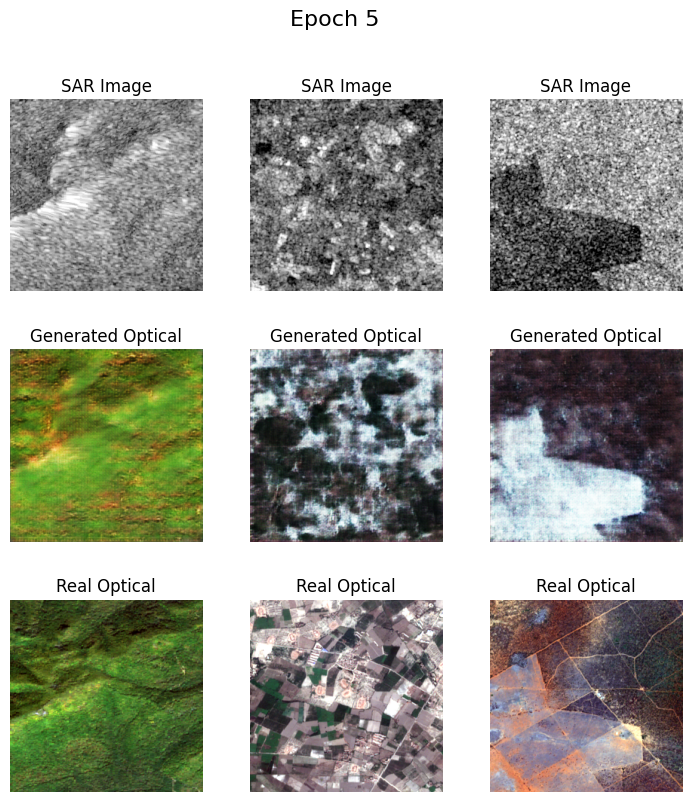

100%|██████████| 900/900 [00:51<00:00, 17.40it/s]


Epoch [6/200], Loss D: 0.9399361610412598, Loss G: 29.614700317382812


100%|██████████| 900/900 [00:51<00:00, 17.39it/s]


Epoch [7/200], Loss D: 0.7803440093994141, Loss G: 28.984203338623047


100%|██████████| 900/900 [00:51<00:00, 17.38it/s]


Epoch [8/200], Loss D: 0.17280223965644836, Loss G: 30.847116470336914


100%|██████████| 900/900 [00:51<00:00, 17.39it/s]


Epoch [9/200], Loss D: 0.2908143401145935, Loss G: 30.35274887084961


100%|██████████| 900/900 [00:51<00:00, 17.38it/s]


Epoch [10/200], Loss D: 0.49102360010147095, Loss G: 25.249679565429688


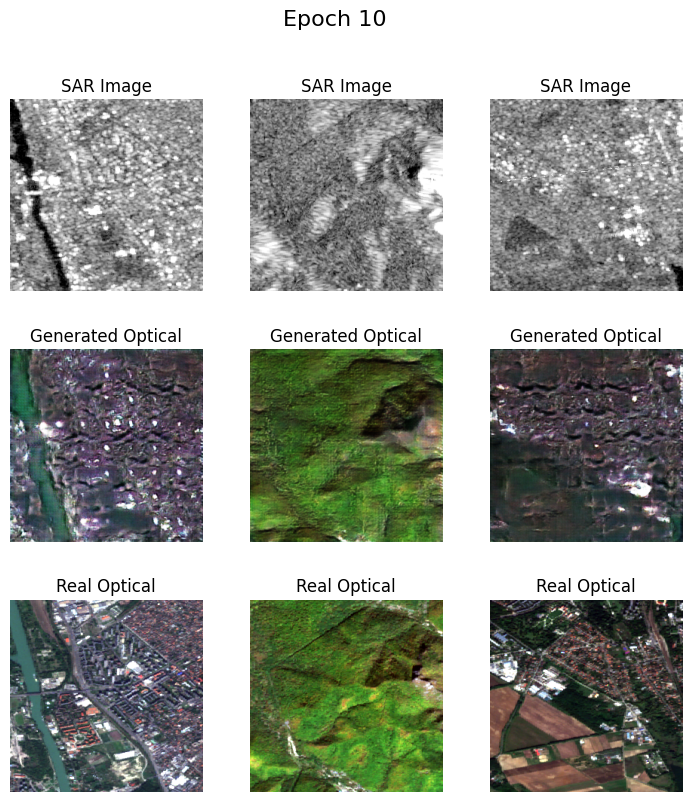

Checkpoint saved at epoch 10


100%|██████████| 900/900 [00:51<00:00, 17.40it/s]


Epoch [11/200], Loss D: 0.9952108263969421, Loss G: 25.057514190673828


100%|██████████| 900/900 [00:51<00:00, 17.39it/s]


Epoch [12/200], Loss D: 0.6011176705360413, Loss G: 26.068769454956055


100%|██████████| 900/900 [00:51<00:00, 17.39it/s]


Epoch [13/200], Loss D: 0.707214891910553, Loss G: 27.098270416259766


100%|██████████| 900/900 [00:51<00:00, 17.37it/s]


Epoch [14/200], Loss D: 0.3427717387676239, Loss G: 30.801254272460938


100%|██████████| 900/900 [00:51<00:00, 17.39it/s]


Epoch [15/200], Loss D: 0.4868308901786804, Loss G: 26.418136596679688


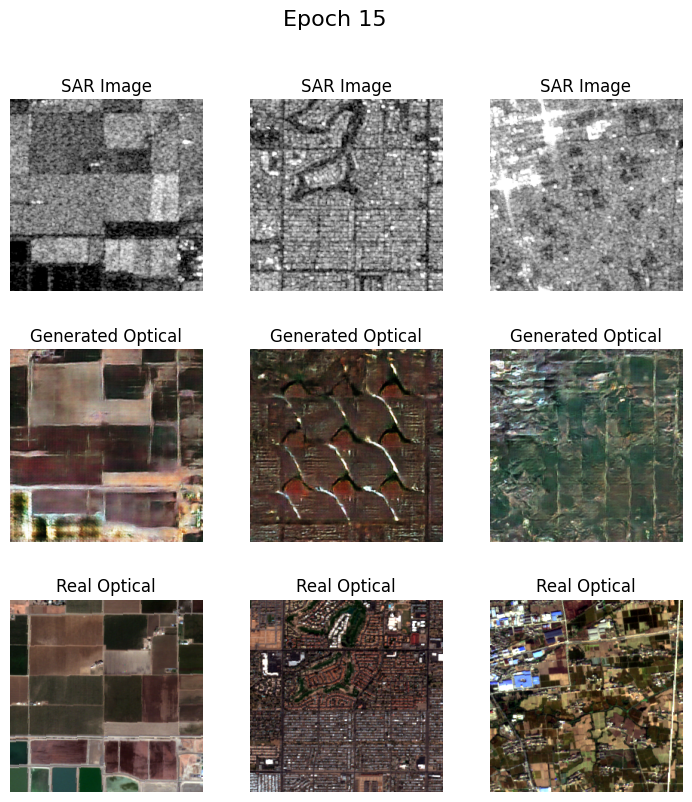

100%|██████████| 900/900 [00:51<00:00, 17.37it/s]


Epoch [16/200], Loss D: 0.7816425561904907, Loss G: 23.608867645263672


100%|██████████| 900/900 [00:51<00:00, 17.37it/s]


Epoch [17/200], Loss D: 0.3594403862953186, Loss G: 22.51303482055664


100%|██████████| 900/900 [00:51<00:00, 17.35it/s]


Epoch [18/200], Loss D: 0.5367104411125183, Loss G: 23.273822784423828


100%|██████████| 900/900 [00:51<00:00, 17.36it/s]


Epoch [19/200], Loss D: 0.4266883432865143, Loss G: 27.511451721191406


100%|██████████| 900/900 [00:51<00:00, 17.38it/s]


Epoch [20/200], Loss D: 0.5698326230049133, Loss G: 24.163644790649414


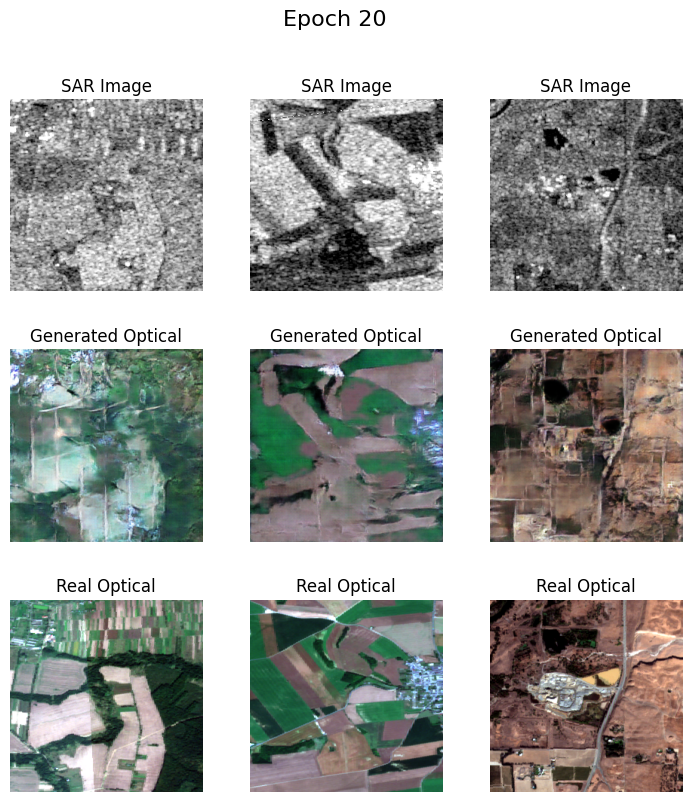

Checkpoint saved at epoch 20


100%|██████████| 900/900 [00:51<00:00, 17.33it/s]


Epoch [21/200], Loss D: 0.5293238759040833, Loss G: 23.728126525878906


100%|██████████| 900/900 [00:51<00:00, 17.35it/s]


Epoch [22/200], Loss D: 0.289874404668808, Loss G: 25.971403121948242


100%|██████████| 900/900 [00:51<00:00, 17.34it/s]


Epoch [23/200], Loss D: 0.2852307856082916, Loss G: 25.239065170288086


100%|██████████| 900/900 [00:51<00:00, 17.35it/s]


Epoch [24/200], Loss D: 0.3435746729373932, Loss G: 24.787654876708984


100%|██████████| 900/900 [00:51<00:00, 17.34it/s]


Epoch [25/200], Loss D: 0.16659028828144073, Loss G: 28.012924194335938


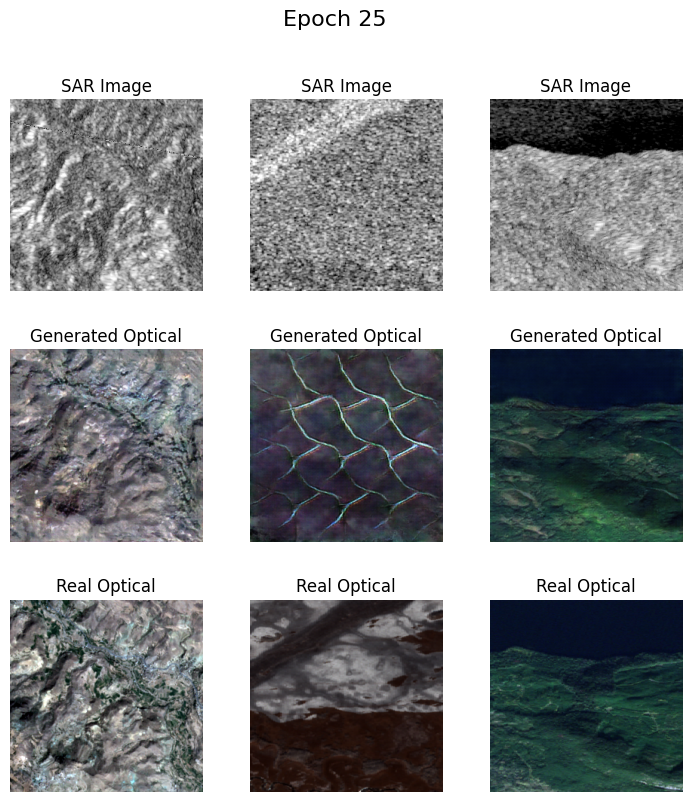

100%|██████████| 900/900 [00:51<00:00, 17.34it/s]


Epoch [26/200], Loss D: 0.31883591413497925, Loss G: 22.60413932800293


100%|██████████| 900/900 [00:51<00:00, 17.34it/s]


Epoch [27/200], Loss D: 0.7501957416534424, Loss G: 21.93211555480957


100%|██████████| 900/900 [00:51<00:00, 17.32it/s]


Epoch [28/200], Loss D: 0.41753363609313965, Loss G: 24.040691375732422


100%|██████████| 900/900 [00:51<00:00, 17.35it/s]


Epoch [29/200], Loss D: 0.48112016916275024, Loss G: 22.210399627685547


100%|██████████| 900/900 [00:51<00:00, 17.34it/s]


Epoch [30/200], Loss D: 0.44551998376846313, Loss G: 23.588054656982422


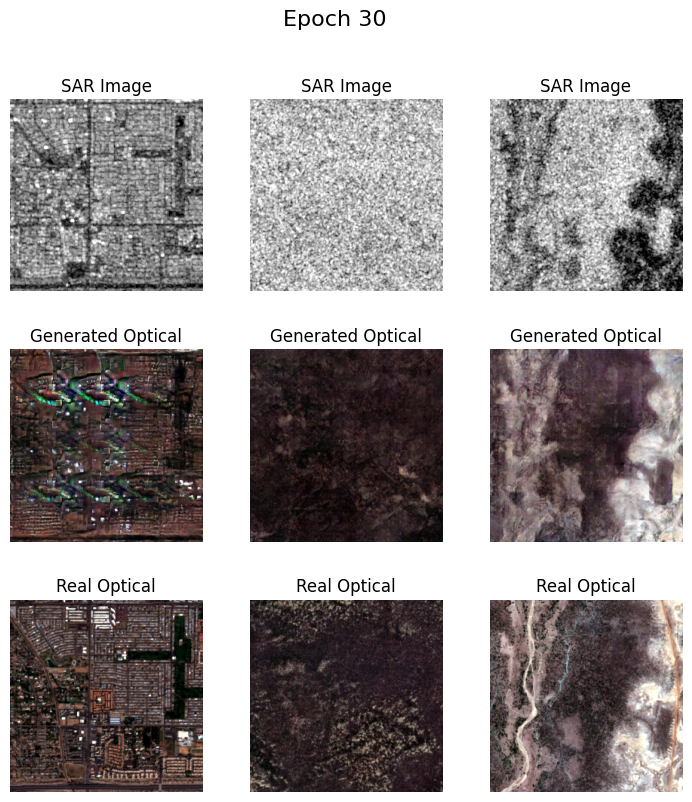

Checkpoint saved at epoch 30


100%|██████████| 900/900 [00:51<00:00, 17.34it/s]


Epoch [31/200], Loss D: 0.5399478077888489, Loss G: 19.991405487060547


100%|██████████| 900/900 [00:51<00:00, 17.35it/s]


Epoch [32/200], Loss D: 0.2069459855556488, Loss G: 25.887678146362305


100%|██████████| 900/900 [00:51<00:00, 17.32it/s]


Epoch [33/200], Loss D: 0.37686634063720703, Loss G: 21.399856567382812


100%|██████████| 900/900 [00:51<00:00, 17.34it/s]


Epoch [34/200], Loss D: 0.28150832653045654, Loss G: 19.416736602783203


100%|██████████| 900/900 [00:51<00:00, 17.34it/s]


Epoch [35/200], Loss D: 0.20658843219280243, Loss G: 21.913379669189453


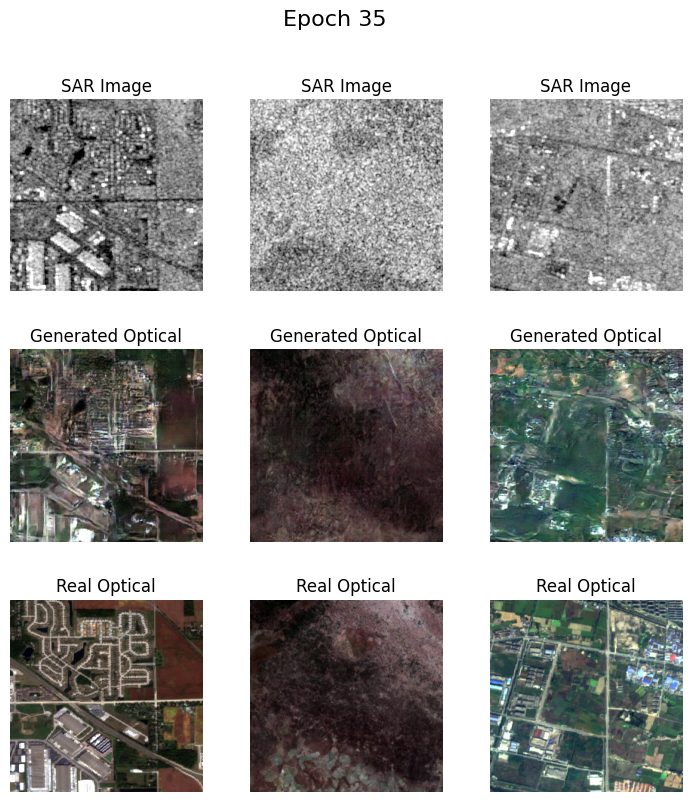

100%|██████████| 900/900 [00:51<00:00, 17.33it/s]


Epoch [36/200], Loss D: 0.42752784490585327, Loss G: 19.69768524169922


100%|██████████| 900/900 [00:51<00:00, 17.33it/s]


Epoch [37/200], Loss D: 0.33203834295272827, Loss G: 20.495689392089844


100%|██████████| 900/900 [00:51<00:00, 17.32it/s]


Epoch [38/200], Loss D: 0.9980459809303284, Loss G: 18.06538200378418


100%|██████████| 900/900 [00:51<00:00, 17.32it/s]


Epoch [39/200], Loss D: 0.607168436050415, Loss G: 20.81489372253418


100%|██████████| 900/900 [00:51<00:00, 17.34it/s]


Epoch [40/200], Loss D: 0.24153289198875427, Loss G: 20.755849838256836


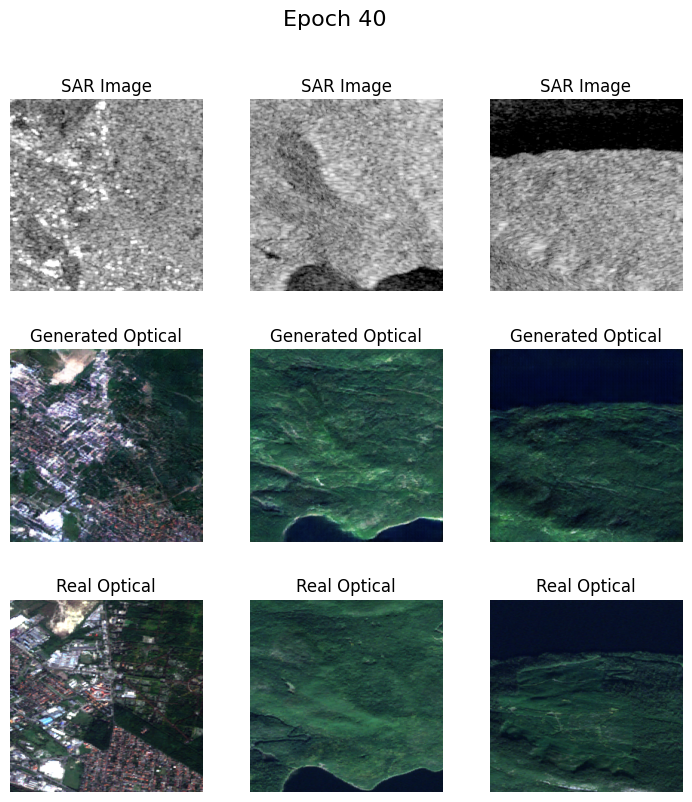

Checkpoint saved at epoch 40


100%|██████████| 900/900 [00:51<00:00, 17.34it/s]


Epoch [41/200], Loss D: 0.3932552933692932, Loss G: 18.848079681396484


100%|██████████| 900/900 [00:51<00:00, 17.33it/s]


Epoch [42/200], Loss D: 0.4525480270385742, Loss G: 18.783790588378906


100%|██████████| 900/900 [00:51<00:00, 17.33it/s]


Epoch [43/200], Loss D: 0.42321714758872986, Loss G: 17.75178337097168


100%|██████████| 900/900 [00:51<00:00, 17.32it/s]


Epoch [44/200], Loss D: 0.4498334228992462, Loss G: 19.89645004272461


100%|██████████| 900/900 [00:51<00:00, 17.33it/s]


Epoch [45/200], Loss D: 0.3508133888244629, Loss G: 19.521516799926758


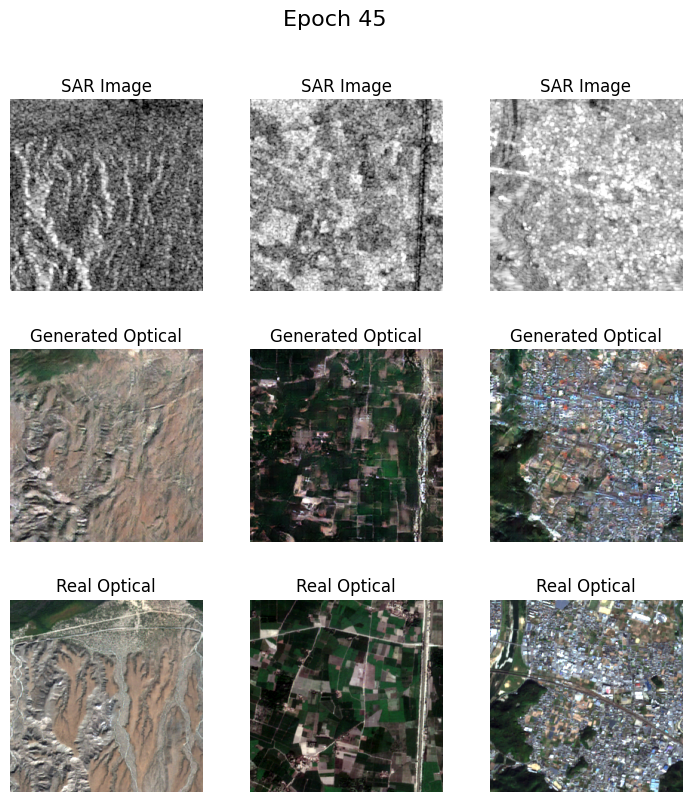

100%|██████████| 900/900 [00:51<00:00, 17.32it/s]


Epoch [46/200], Loss D: 0.21159593760967255, Loss G: 22.502134323120117


100%|██████████| 900/900 [00:51<00:00, 17.32it/s]


Epoch [47/200], Loss D: 0.269999623298645, Loss G: 21.53130340576172


100%|██████████| 900/900 [00:51<00:00, 17.33it/s]


Epoch [48/200], Loss D: 0.24839314818382263, Loss G: 19.718135833740234


100%|██████████| 900/900 [00:51<00:00, 17.32it/s]


Epoch [49/200], Loss D: 0.3290163278579712, Loss G: 21.346834182739258


100%|██████████| 900/900 [00:51<00:00, 17.31it/s]


Epoch [50/200], Loss D: 0.31016016006469727, Loss G: 18.729284286499023


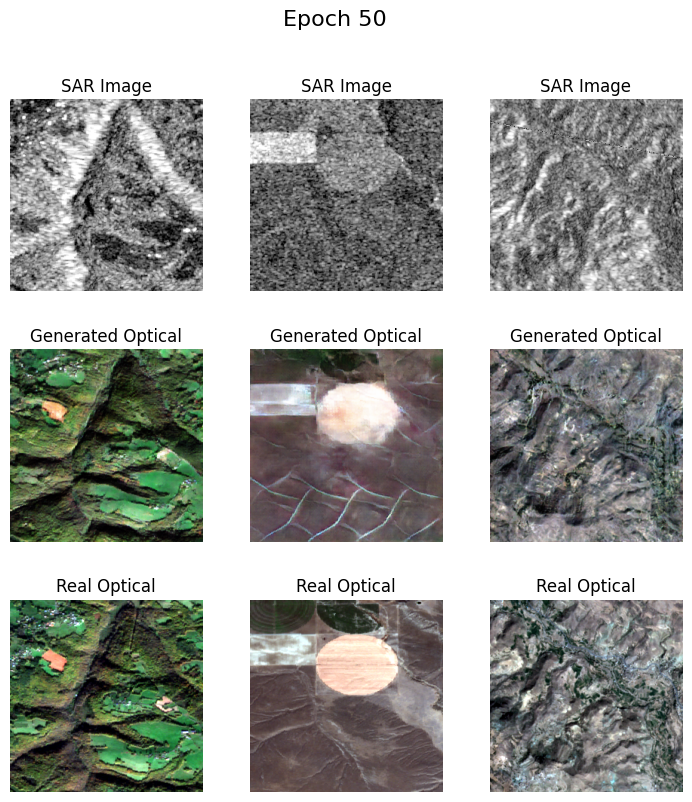

Checkpoint saved at epoch 50


100%|██████████| 900/900 [00:51<00:00, 17.33it/s]


Epoch [51/200], Loss D: 0.3921123147010803, Loss G: 20.321020126342773


100%|██████████| 900/900 [00:51<00:00, 17.32it/s]


Epoch [52/200], Loss D: 0.35096508264541626, Loss G: 16.128944396972656


100%|██████████| 900/900 [00:51<00:00, 17.32it/s]


Epoch [53/200], Loss D: 0.6783108115196228, Loss G: 18.937252044677734


100%|██████████| 900/900 [00:51<00:00, 17.31it/s]


Epoch [54/200], Loss D: 0.27932077646255493, Loss G: 17.30097007751465


100%|██████████| 900/900 [00:51<00:00, 17.32it/s]


Epoch [55/200], Loss D: 0.3603162169456482, Loss G: 19.49993896484375


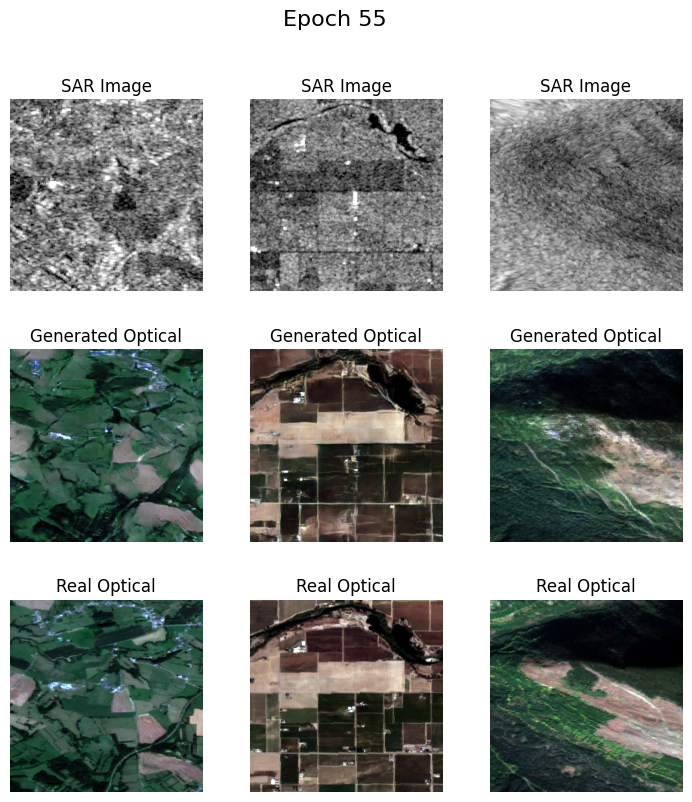

100%|██████████| 900/900 [00:52<00:00, 17.30it/s]


Epoch [56/200], Loss D: 0.2502101957798004, Loss G: 19.337718963623047


100%|██████████| 900/900 [00:52<00:00, 17.30it/s]


Epoch [57/200], Loss D: 0.4463484287261963, Loss G: 18.427181243896484


100%|██████████| 900/900 [00:52<00:00, 17.30it/s]


Epoch [58/200], Loss D: 0.5509475469589233, Loss G: 16.426599502563477


100%|██████████| 900/900 [00:52<00:00, 17.30it/s]


Epoch [59/200], Loss D: 0.2746298313140869, Loss G: 17.421951293945312


100%|██████████| 900/900 [00:51<00:00, 17.31it/s]


Epoch [60/200], Loss D: 0.3819029927253723, Loss G: 21.567657470703125


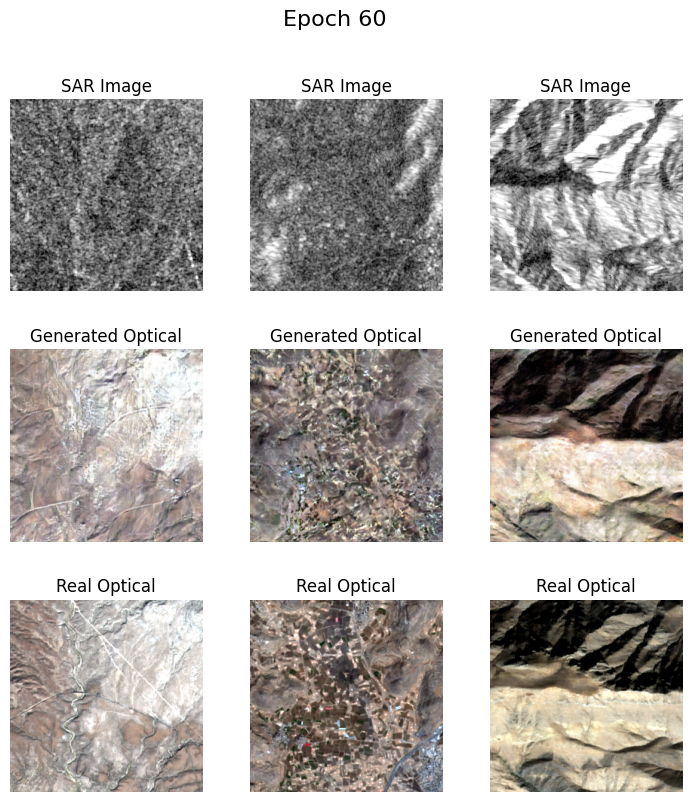

Checkpoint saved at epoch 60


100%|██████████| 900/900 [00:51<00:00, 17.32it/s]


Epoch [61/200], Loss D: 1.0038098096847534, Loss G: 18.62077522277832


100%|██████████| 900/900 [00:52<00:00, 17.29it/s]


Epoch [62/200], Loss D: 1.1942719221115112, Loss G: 19.58529281616211


100%|██████████| 900/900 [00:52<00:00, 17.30it/s]


Epoch [63/200], Loss D: 0.5815165042877197, Loss G: 19.755897521972656


100%|██████████| 900/900 [00:52<00:00, 17.29it/s]


Epoch [64/200], Loss D: 0.35478121042251587, Loss G: 16.006084442138672


100%|██████████| 900/900 [00:52<00:00, 17.29it/s]


Epoch [65/200], Loss D: 0.3725477159023285, Loss G: 17.869455337524414


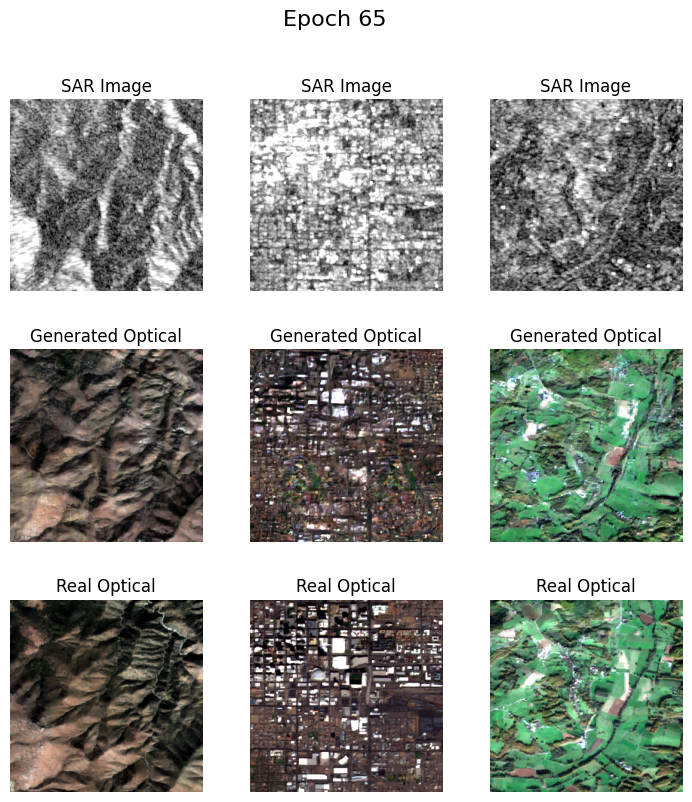

100%|██████████| 900/900 [00:52<00:00, 17.29it/s]


Epoch [66/200], Loss D: 0.7047672271728516, Loss G: 19.552818298339844


100%|██████████| 900/900 [00:52<00:00, 17.29it/s]


Epoch [67/200], Loss D: 0.30502834916114807, Loss G: 19.804676055908203


100%|██████████| 900/900 [00:52<00:00, 17.30it/s]


Epoch [68/200], Loss D: 0.48571398854255676, Loss G: 16.021541595458984


100%|██████████| 900/900 [00:52<00:00, 17.28it/s]


Epoch [69/200], Loss D: 0.28980040550231934, Loss G: 18.057397842407227


100%|██████████| 900/900 [00:52<00:00, 17.27it/s]


Epoch [70/200], Loss D: 0.2286664843559265, Loss G: 18.795377731323242


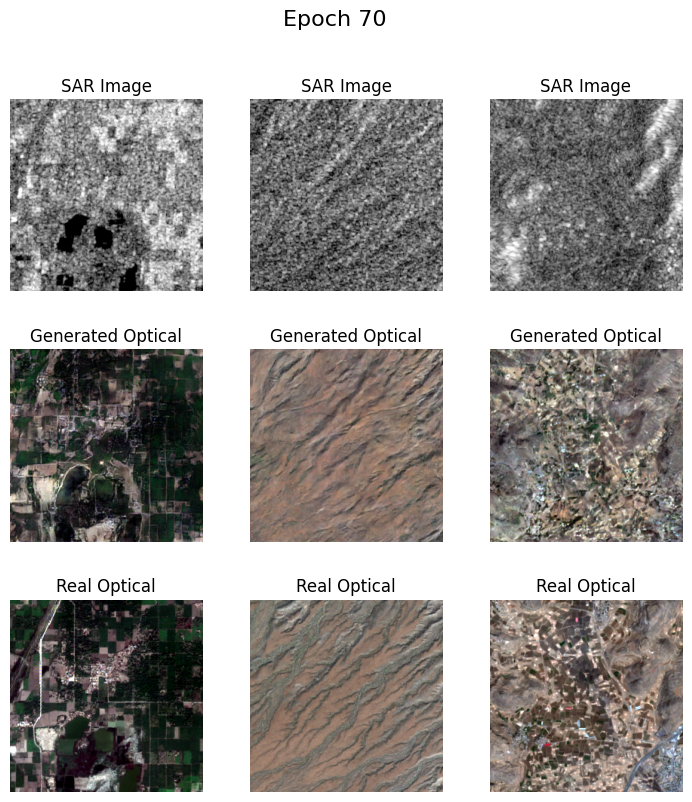

Checkpoint saved at epoch 70


100%|██████████| 900/900 [00:52<00:00, 17.28it/s]


Epoch [71/200], Loss D: 0.45599645376205444, Loss G: 18.489871978759766


100%|██████████| 900/900 [00:52<00:00, 17.29it/s]


Epoch [72/200], Loss D: 0.29007604718208313, Loss G: 18.961252212524414


100%|██████████| 900/900 [00:52<00:00, 17.30it/s]


Epoch [73/200], Loss D: 0.28015270829200745, Loss G: 19.382034301757812


100%|██████████| 900/900 [00:52<00:00, 17.31it/s]


Epoch [74/200], Loss D: 0.6201149821281433, Loss G: 18.282760620117188


100%|██████████| 900/900 [00:52<00:00, 17.29it/s]


Epoch [75/200], Loss D: 0.268235445022583, Loss G: 20.512062072753906


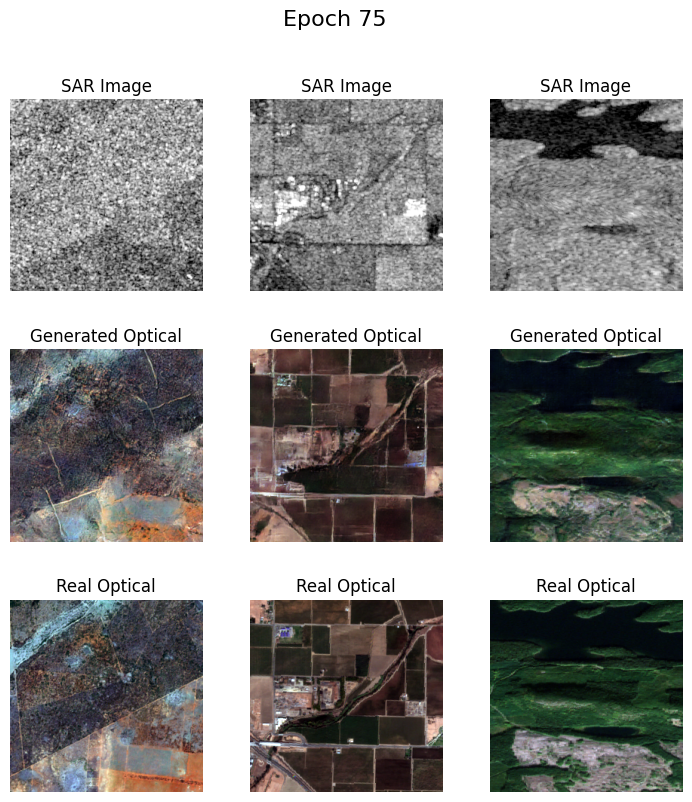

100%|██████████| 900/900 [00:52<00:00, 17.28it/s]


Epoch [76/200], Loss D: 0.6110961437225342, Loss G: 19.372657775878906


100%|██████████| 900/900 [00:52<00:00, 17.29it/s]


Epoch [77/200], Loss D: 0.2702311873435974, Loss G: 19.131168365478516


100%|██████████| 900/900 [00:52<00:00, 17.28it/s]


Epoch [78/200], Loss D: 0.4854728579521179, Loss G: 16.748090744018555


100%|██████████| 900/900 [00:52<00:00, 17.29it/s]


Epoch [79/200], Loss D: 0.325374960899353, Loss G: 18.01011848449707


100%|██████████| 900/900 [00:52<00:00, 17.29it/s]


Epoch [80/200], Loss D: 0.6293625235557556, Loss G: 19.667572021484375


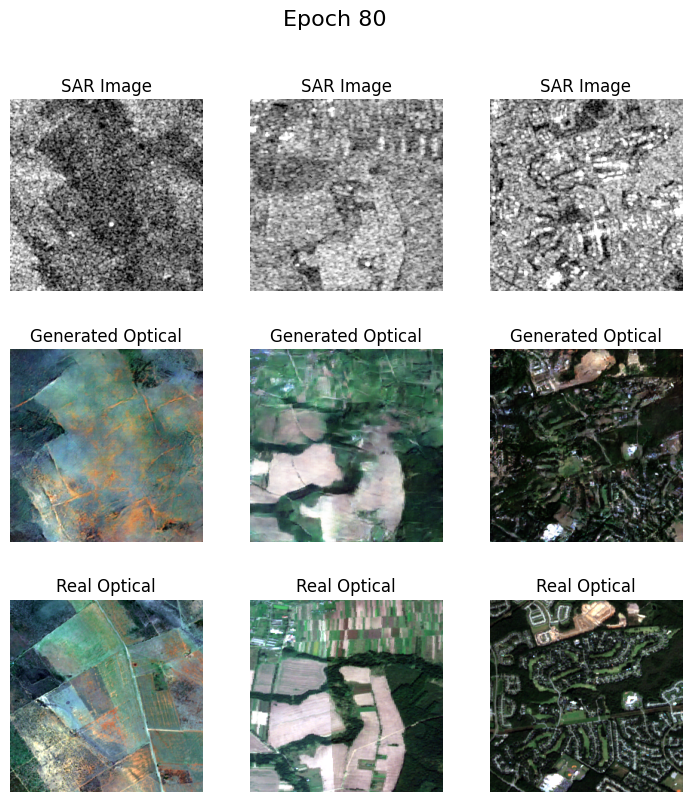

Checkpoint saved at epoch 80


100%|██████████| 900/900 [00:52<00:00, 17.28it/s]


Epoch [81/200], Loss D: 0.20591476559638977, Loss G: 19.52521324157715


100%|██████████| 900/900 [00:52<00:00, 17.30it/s]


Epoch [82/200], Loss D: 0.593911349773407, Loss G: 17.329212188720703


100%|██████████| 900/900 [00:52<00:00, 17.29it/s]


Epoch [83/200], Loss D: 0.7409671545028687, Loss G: 18.474185943603516


100%|██████████| 900/900 [00:52<00:00, 17.29it/s]


Epoch [84/200], Loss D: 0.37756842374801636, Loss G: 17.07585906982422


100%|██████████| 900/900 [00:52<00:00, 17.29it/s]


Epoch [85/200], Loss D: 0.33211344480514526, Loss G: 16.953031539916992


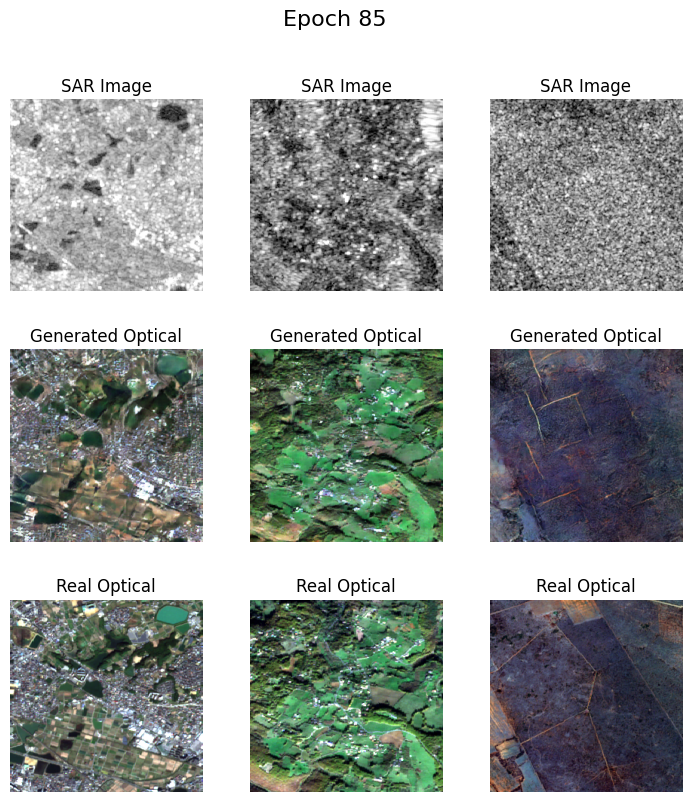

100%|██████████| 900/900 [00:52<00:00, 17.29it/s]


Epoch [86/200], Loss D: 0.34379690885543823, Loss G: 15.727195739746094


100%|██████████| 900/900 [00:52<00:00, 17.29it/s]


Epoch [87/200], Loss D: 0.15629801154136658, Loss G: 18.734901428222656


100%|██████████| 900/900 [00:52<00:00, 17.29it/s]


Epoch [88/200], Loss D: 0.4209080636501312, Loss G: 16.906375885009766


100%|██████████| 900/900 [00:52<00:00, 17.29it/s]


Epoch [89/200], Loss D: 0.885150134563446, Loss G: 18.327373504638672


100%|██████████| 900/900 [00:52<00:00, 17.28it/s]


Epoch [90/200], Loss D: 0.3567136228084564, Loss G: 17.55091094970703


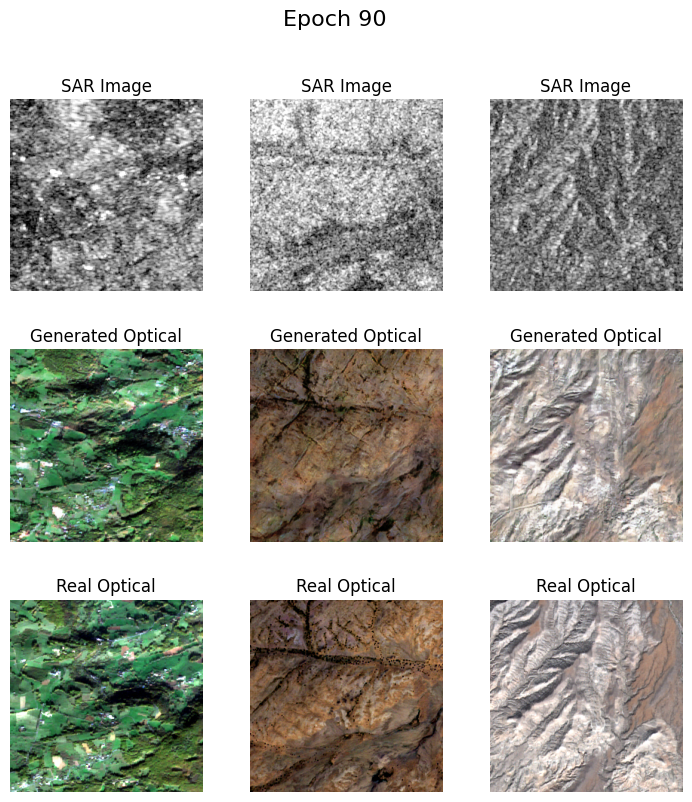

Checkpoint saved at epoch 90


100%|██████████| 900/900 [00:52<00:00, 17.30it/s]


Epoch [91/200], Loss D: 0.49534285068511963, Loss G: 17.99106788635254


100%|██████████| 900/900 [00:52<00:00, 17.29it/s]


Epoch [92/200], Loss D: 0.4637027978897095, Loss G: 15.886649131774902


100%|██████████| 900/900 [00:52<00:00, 17.29it/s]


Epoch [93/200], Loss D: 0.5121349692344666, Loss G: 17.504779815673828


100%|██████████| 900/900 [00:52<00:00, 17.30it/s]


Epoch [94/200], Loss D: 0.9466935396194458, Loss G: 18.795278549194336


100%|██████████| 900/900 [00:51<00:00, 17.31it/s]


Epoch [95/200], Loss D: 0.4297073781490326, Loss G: 15.95224380493164


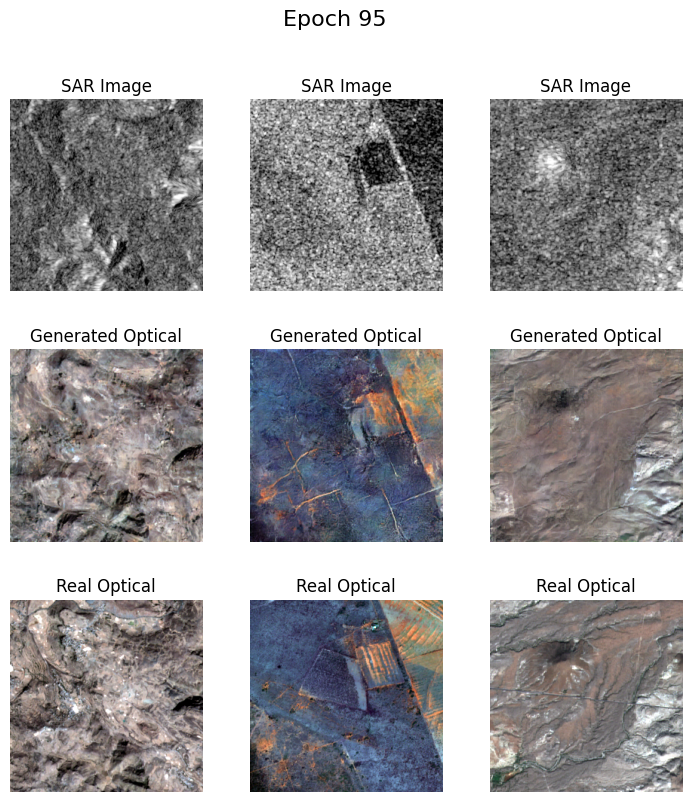

100%|██████████| 900/900 [00:52<00:00, 17.27it/s]


Epoch [96/200], Loss D: 0.4348301887512207, Loss G: 16.63410186767578


100%|██████████| 900/900 [00:52<00:00, 17.27it/s]


Epoch [97/200], Loss D: 0.3748207092285156, Loss G: 15.7852144241333


100%|██████████| 900/900 [00:52<00:00, 17.27it/s]


Epoch [98/200], Loss D: 0.3340770900249481, Loss G: 18.407642364501953


100%|██████████| 900/900 [00:52<00:00, 17.26it/s]


Epoch [99/200], Loss D: 0.5322384834289551, Loss G: 17.385452270507812


100%|██████████| 900/900 [00:52<00:00, 17.28it/s]


Epoch [100/200], Loss D: 0.5042760372161865, Loss G: 18.2526912689209


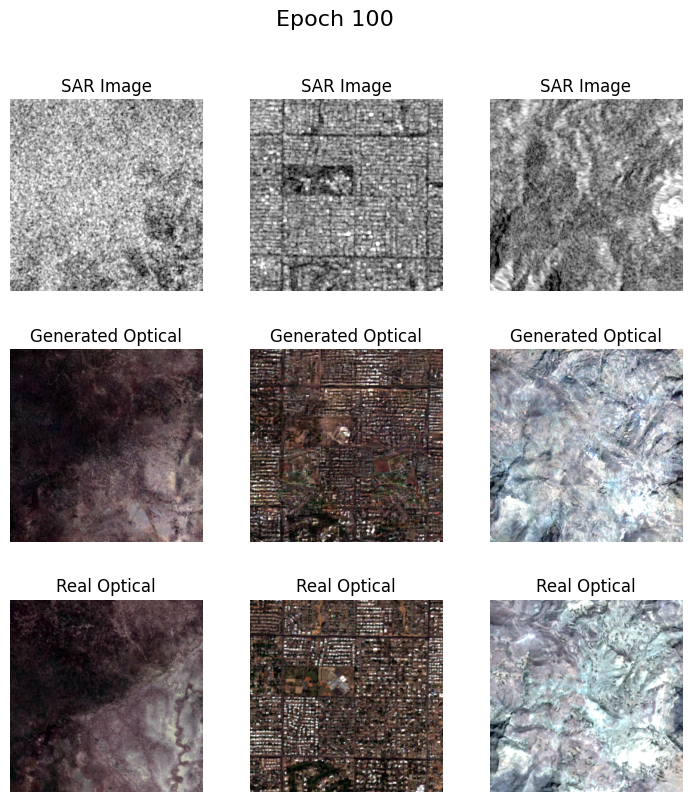

Checkpoint saved at epoch 100


100%|██████████| 900/900 [00:52<00:00, 17.29it/s]


Epoch [101/200], Loss D: 0.34401988983154297, Loss G: 16.323192596435547


100%|██████████| 900/900 [00:52<00:00, 17.30it/s]


Epoch [102/200], Loss D: 0.8709582090377808, Loss G: 16.478717803955078


100%|██████████| 900/900 [00:52<00:00, 17.30it/s]


Epoch [103/200], Loss D: 0.31571030616760254, Loss G: 17.06966781616211


100%|██████████| 900/900 [00:52<00:00, 17.28it/s]


Epoch [104/200], Loss D: 0.5691210031509399, Loss G: 15.716011047363281


100%|██████████| 900/900 [00:52<00:00, 17.28it/s]


Epoch [105/200], Loss D: 0.4374115467071533, Loss G: 16.818771362304688


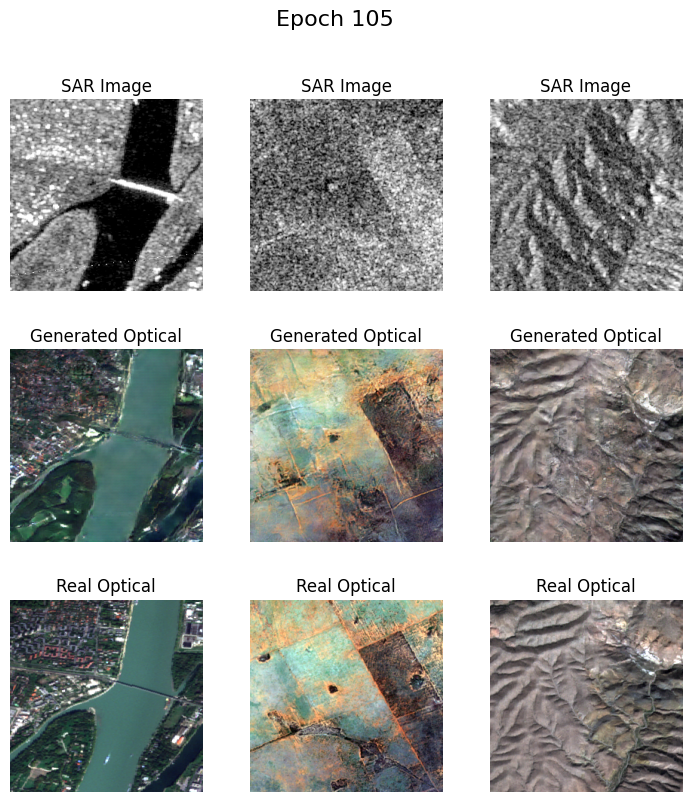

100%|██████████| 900/900 [00:52<00:00, 17.27it/s]


Epoch [106/200], Loss D: 0.5162166953086853, Loss G: 19.075864791870117


100%|██████████| 900/900 [00:52<00:00, 17.26it/s]


Epoch [107/200], Loss D: 1.1430567502975464, Loss G: 15.696731567382812


100%|██████████| 900/900 [00:52<00:00, 17.29it/s]


Epoch [108/200], Loss D: 0.3158915340900421, Loss G: 16.986724853515625


100%|██████████| 900/900 [00:52<00:00, 17.27it/s]


Epoch [109/200], Loss D: 0.414793998003006, Loss G: 15.789886474609375


100%|██████████| 900/900 [00:52<00:00, 17.27it/s]


Epoch [110/200], Loss D: 0.33008942008018494, Loss G: 16.946868896484375


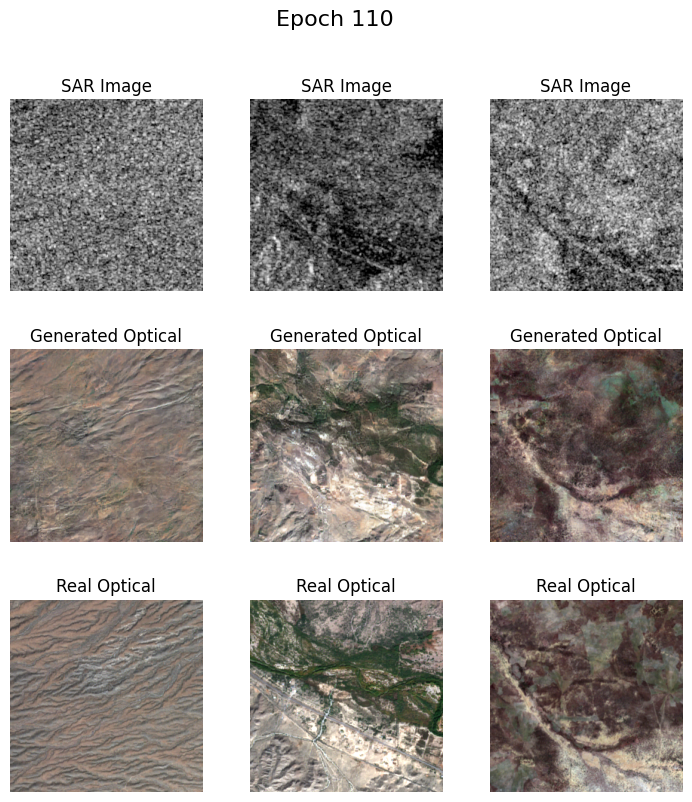

Checkpoint saved at epoch 110


100%|██████████| 900/900 [00:52<00:00, 17.29it/s]


Epoch [111/200], Loss D: 0.8441816568374634, Loss G: 20.659337997436523


100%|██████████| 900/900 [00:52<00:00, 17.29it/s]


Epoch [112/200], Loss D: 0.38853535056114197, Loss G: 18.531251907348633


100%|██████████| 900/900 [00:52<00:00, 17.27it/s]


Epoch [113/200], Loss D: 0.5309267640113831, Loss G: 15.578729629516602


100%|██████████| 900/900 [00:52<00:00, 17.27it/s]


Epoch [114/200], Loss D: 0.41256242990493774, Loss G: 18.976600646972656


100%|██████████| 900/900 [00:52<00:00, 17.27it/s]


Epoch [115/200], Loss D: 0.2630312442779541, Loss G: 18.0440731048584


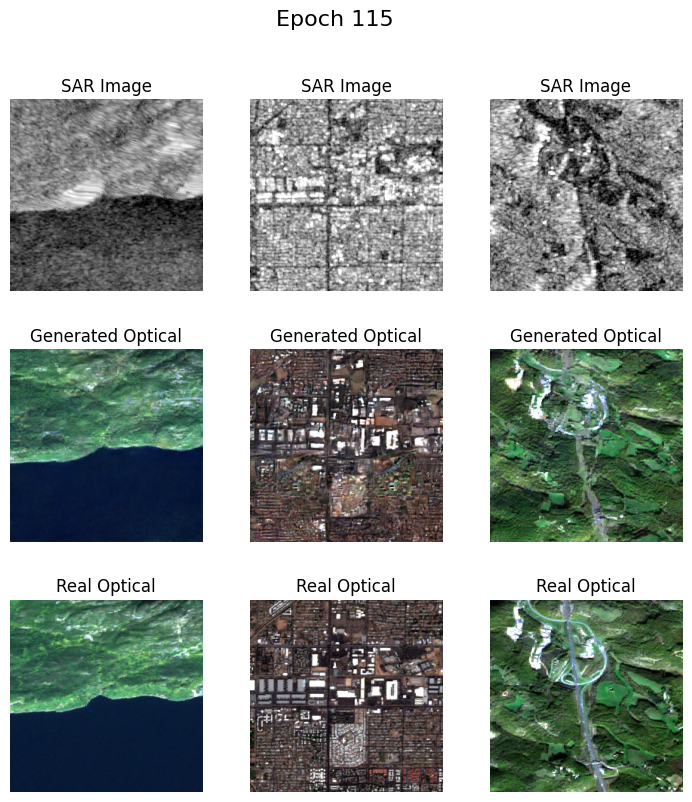

100%|██████████| 900/900 [00:52<00:00, 17.27it/s]


Epoch [116/200], Loss D: 0.3738905191421509, Loss G: 20.415773391723633


100%|██████████| 900/900 [00:52<00:00, 17.28it/s]


Epoch [117/200], Loss D: 0.34528616070747375, Loss G: 18.755714416503906


100%|██████████| 900/900 [00:52<00:00, 17.27it/s]


Epoch [118/200], Loss D: 0.46178755164146423, Loss G: 15.45323371887207


100%|██████████| 900/900 [00:52<00:00, 17.27it/s]


Epoch [119/200], Loss D: 0.2694372534751892, Loss G: 15.009255409240723


100%|██████████| 900/900 [00:52<00:00, 17.28it/s]


Epoch [120/200], Loss D: 0.27425339818000793, Loss G: 15.809391021728516


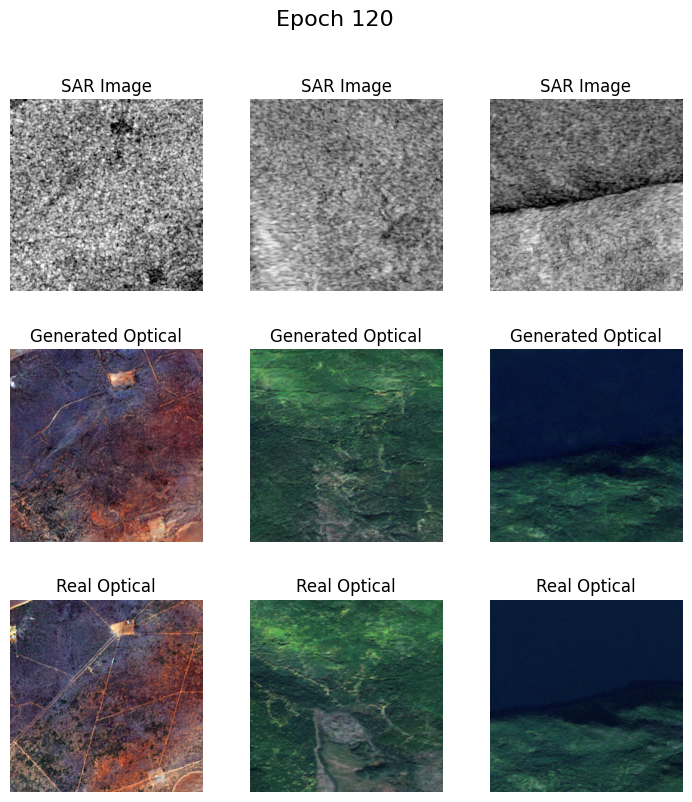

Checkpoint saved at epoch 120


100%|██████████| 900/900 [00:52<00:00, 17.27it/s]


Epoch [121/200], Loss D: 0.5727732181549072, Loss G: 17.33526039123535


100%|██████████| 900/900 [00:52<00:00, 17.29it/s]


Epoch [122/200], Loss D: 0.28407561779022217, Loss G: 18.22640609741211


100%|██████████| 900/900 [00:52<00:00, 17.30it/s]


Epoch [123/200], Loss D: 0.38828936219215393, Loss G: 16.488649368286133


100%|██████████| 900/900 [00:52<00:00, 17.27it/s]


Epoch [124/200], Loss D: 0.2859402298927307, Loss G: 16.191383361816406


100%|██████████| 900/900 [00:52<00:00, 17.28it/s]


Epoch [125/200], Loss D: 0.386544793844223, Loss G: 16.096302032470703


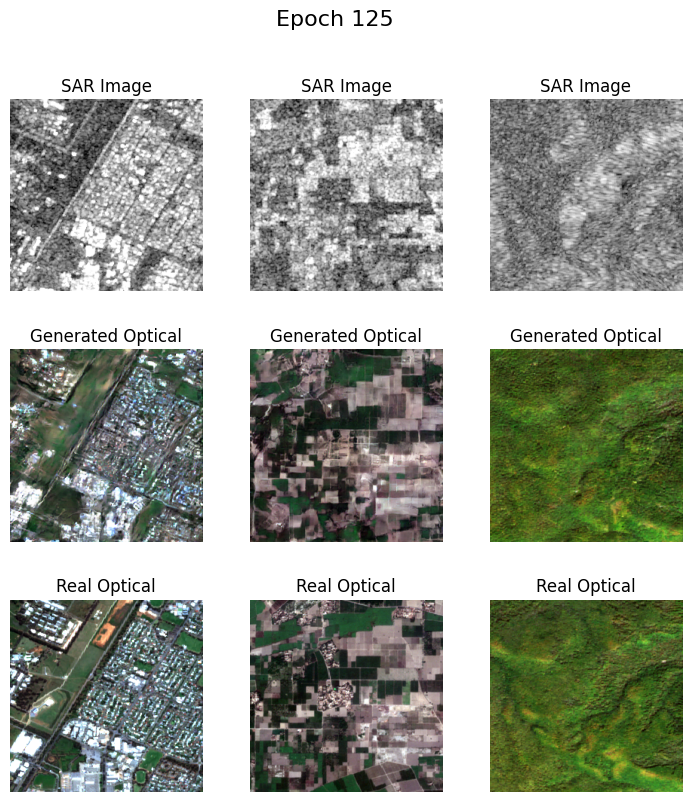

100%|██████████| 900/900 [00:52<00:00, 17.25it/s]


Epoch [126/200], Loss D: 0.41094961762428284, Loss G: 15.761798858642578


100%|██████████| 900/900 [00:52<00:00, 17.26it/s]


Epoch [127/200], Loss D: 0.6404605507850647, Loss G: 19.142240524291992


100%|██████████| 900/900 [00:52<00:00, 17.28it/s]


Epoch [128/200], Loss D: 0.23209646344184875, Loss G: 17.416160583496094


100%|██████████| 900/900 [00:52<00:00, 17.27it/s]


Epoch [129/200], Loss D: 1.090371012687683, Loss G: 18.783784866333008


100%|██████████| 900/900 [00:52<00:00, 17.26it/s]


Epoch [130/200], Loss D: 0.4136422574520111, Loss G: 14.209640502929688


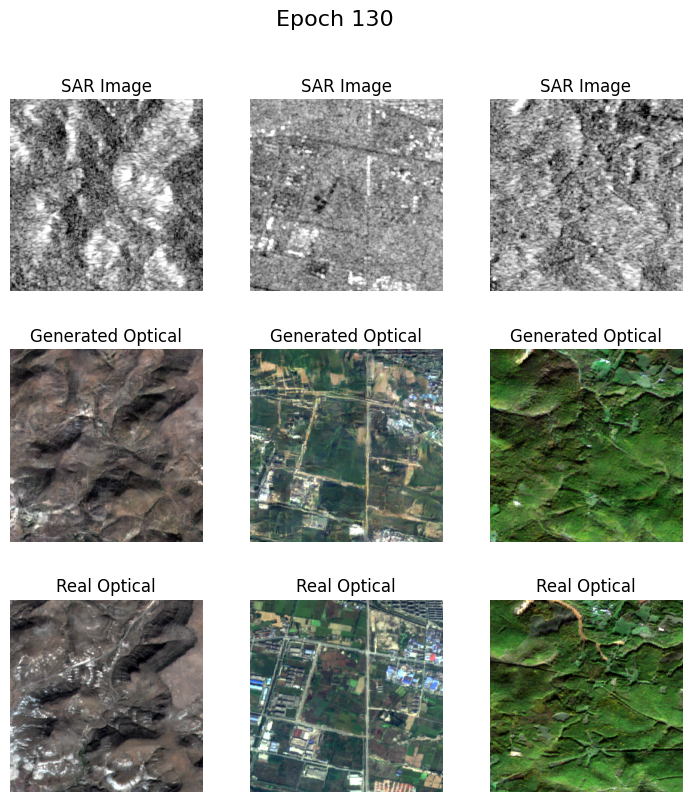

Checkpoint saved at epoch 130


100%|██████████| 900/900 [00:52<00:00, 17.28it/s]


Epoch [131/200], Loss D: 0.28775182366371155, Loss G: 17.41298484802246


100%|██████████| 900/900 [00:52<00:00, 17.30it/s]


Epoch [132/200], Loss D: 0.4675969183444977, Loss G: 19.11456298828125


100%|██████████| 900/900 [00:52<00:00, 17.28it/s]


Epoch [133/200], Loss D: 0.33411505818367004, Loss G: 17.010038375854492


100%|██████████| 900/900 [00:52<00:00, 17.28it/s]


Epoch [134/200], Loss D: 0.2854143977165222, Loss G: 16.600414276123047


100%|██████████| 900/900 [00:52<00:00, 17.28it/s]


Epoch [135/200], Loss D: 0.280438095331192, Loss G: 15.78538703918457


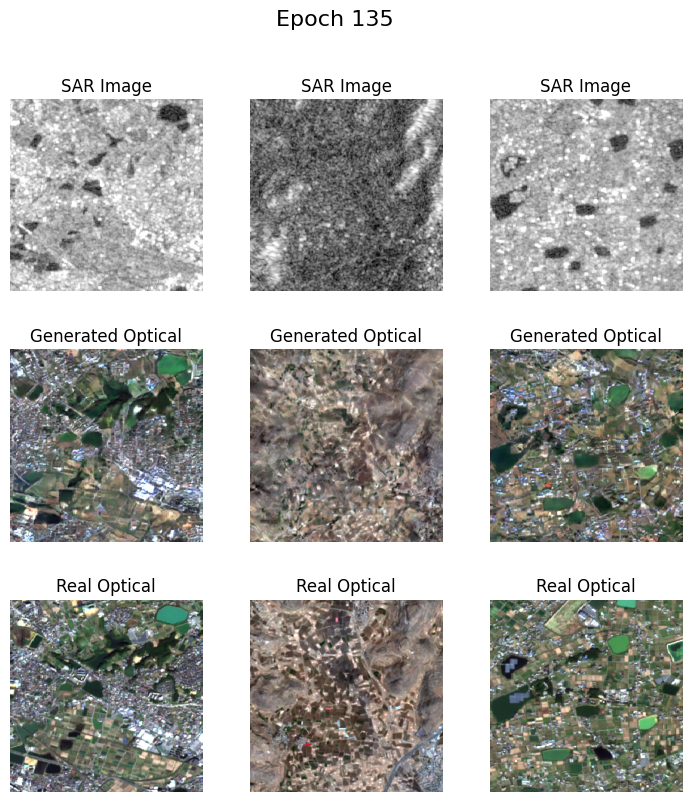

100%|██████████| 900/900 [00:52<00:00, 17.28it/s]


Epoch [136/200], Loss D: 0.33721864223480225, Loss G: 17.03502082824707


100%|██████████| 900/900 [00:52<00:00, 17.28it/s]


Epoch [137/200], Loss D: 0.24989396333694458, Loss G: 17.917247772216797


100%|██████████| 900/900 [00:52<00:00, 17.28it/s]


Epoch [138/200], Loss D: 0.3655864894390106, Loss G: 15.932663917541504


100%|██████████| 900/900 [00:52<00:00, 17.27it/s]


Epoch [139/200], Loss D: 0.6521270275115967, Loss G: 18.292583465576172


100%|██████████| 900/900 [00:52<00:00, 17.28it/s]


Epoch [140/200], Loss D: 0.45297062397003174, Loss G: 16.774789810180664


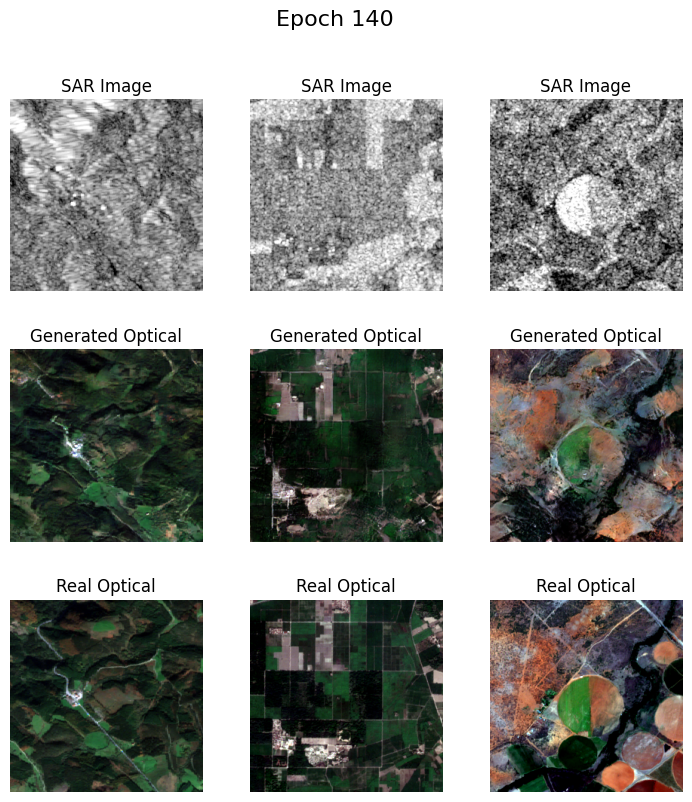

Checkpoint saved at epoch 140


100%|██████████| 900/900 [00:52<00:00, 17.29it/s]


Epoch [141/200], Loss D: 0.3879268765449524, Loss G: 16.8956356048584


100%|██████████| 900/900 [00:52<00:00, 17.28it/s]


Epoch [142/200], Loss D: 0.32424503564834595, Loss G: 16.906089782714844


100%|██████████| 900/900 [00:52<00:00, 17.29it/s]


Epoch [143/200], Loss D: 0.24965599179267883, Loss G: 16.261310577392578


100%|██████████| 900/900 [00:52<00:00, 17.28it/s]


Epoch [144/200], Loss D: 0.5422152876853943, Loss G: 16.373193740844727


100%|██████████| 900/900 [00:52<00:00, 17.28it/s]


Epoch [145/200], Loss D: 0.3773322105407715, Loss G: 13.102802276611328


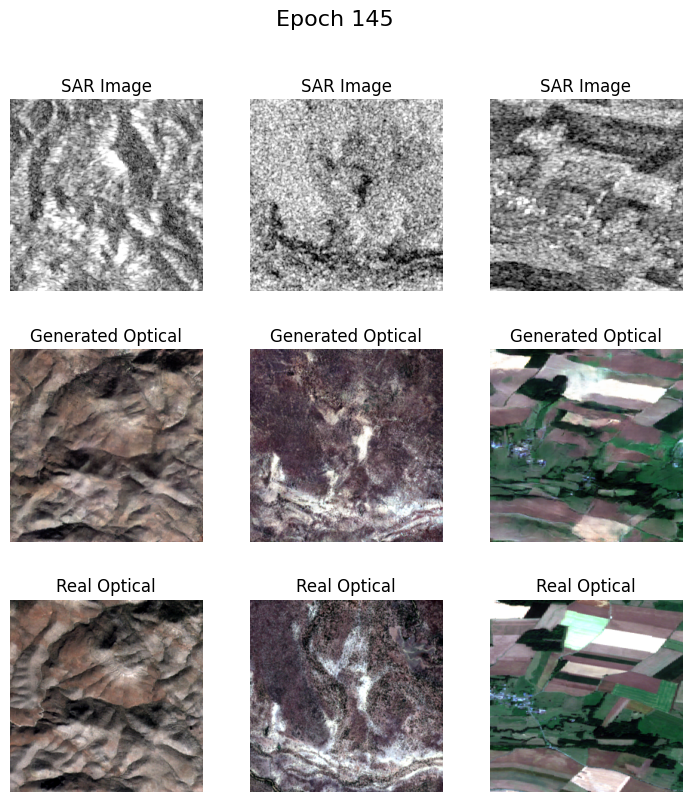

100%|██████████| 900/900 [00:52<00:00, 17.25it/s]


Epoch [146/200], Loss D: 0.38765382766723633, Loss G: 16.440956115722656


100%|██████████| 900/900 [00:52<00:00, 17.27it/s]


Epoch [147/200], Loss D: 0.3289825916290283, Loss G: 17.310014724731445


100%|██████████| 900/900 [00:52<00:00, 17.23it/s]


Epoch [148/200], Loss D: 0.3567286431789398, Loss G: 16.882892608642578


100%|██████████| 900/900 [00:52<00:00, 17.27it/s]


Epoch [149/200], Loss D: 0.36774158477783203, Loss G: 16.40450668334961


100%|██████████| 900/900 [00:52<00:00, 17.25it/s]


Epoch [150/200], Loss D: 0.22596319019794464, Loss G: 16.206525802612305


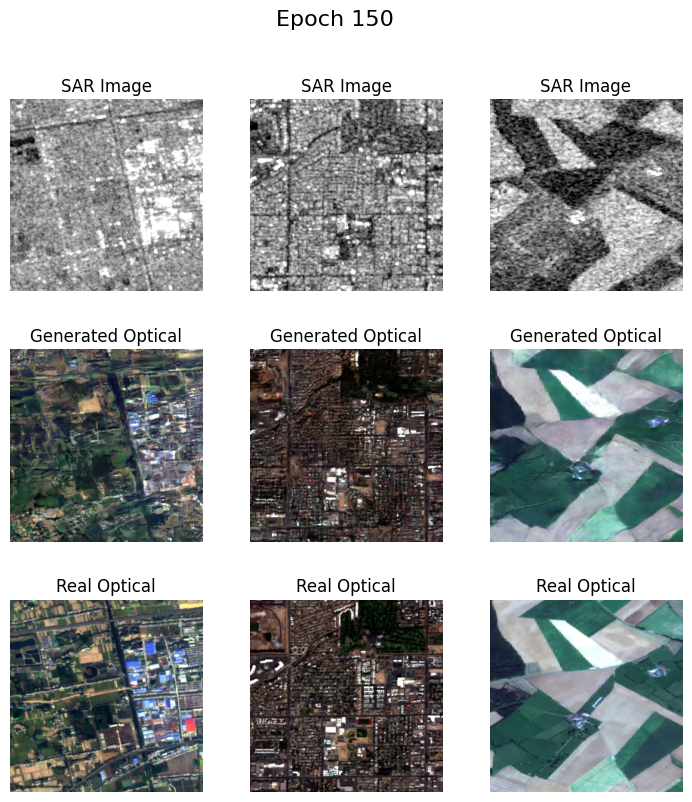

Checkpoint saved at epoch 150


100%|██████████| 900/900 [00:52<00:00, 17.27it/s]


Epoch [151/200], Loss D: 0.32617467641830444, Loss G: 19.161483764648438


100%|██████████| 900/900 [00:52<00:00, 17.27it/s]


Epoch [152/200], Loss D: 0.26221615076065063, Loss G: 16.75272560119629


100%|██████████| 900/900 [00:52<00:00, 17.27it/s]


Epoch [153/200], Loss D: 0.44943439960479736, Loss G: 17.24403190612793


100%|██████████| 900/900 [00:52<00:00, 17.26it/s]


Epoch [154/200], Loss D: 0.5491839051246643, Loss G: 14.811266899108887


100%|██████████| 900/900 [00:52<00:00, 17.27it/s]


Epoch [155/200], Loss D: 0.30403777956962585, Loss G: 15.295082092285156


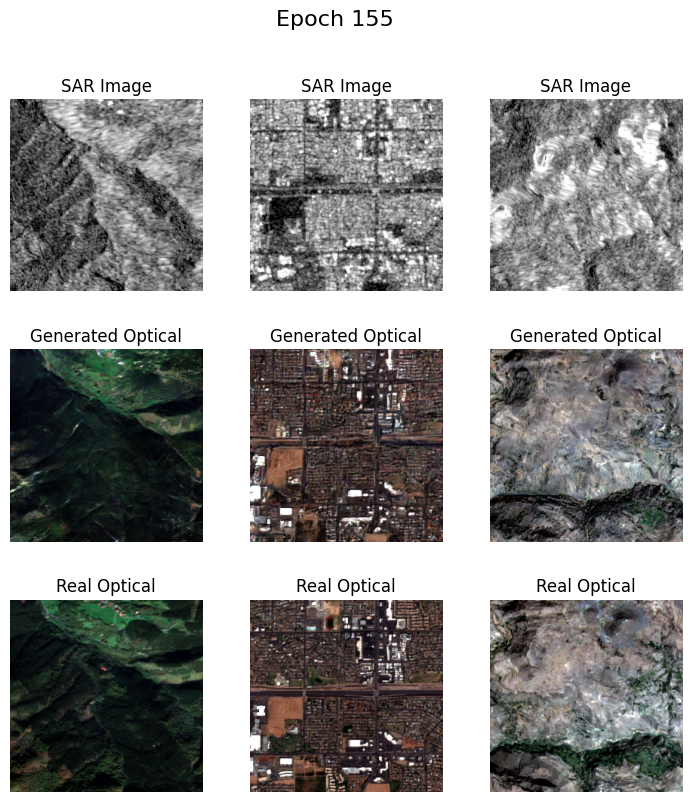

100%|██████████| 900/900 [00:52<00:00, 17.26it/s]


Epoch [156/200], Loss D: 0.6133556365966797, Loss G: 14.90011215209961


100%|██████████| 900/900 [00:52<00:00, 17.27it/s]


Epoch [157/200], Loss D: 0.5771687626838684, Loss G: 13.438027381896973


100%|██████████| 900/900 [00:52<00:00, 17.25it/s]


Epoch [158/200], Loss D: 0.6570535898208618, Loss G: 16.236047744750977


100%|██████████| 900/900 [00:52<00:00, 17.26it/s]


Epoch [159/200], Loss D: 0.42685365676879883, Loss G: 16.88136863708496


100%|██████████| 900/900 [00:52<00:00, 17.27it/s]


Epoch [160/200], Loss D: 0.3729982376098633, Loss G: 16.356338500976562


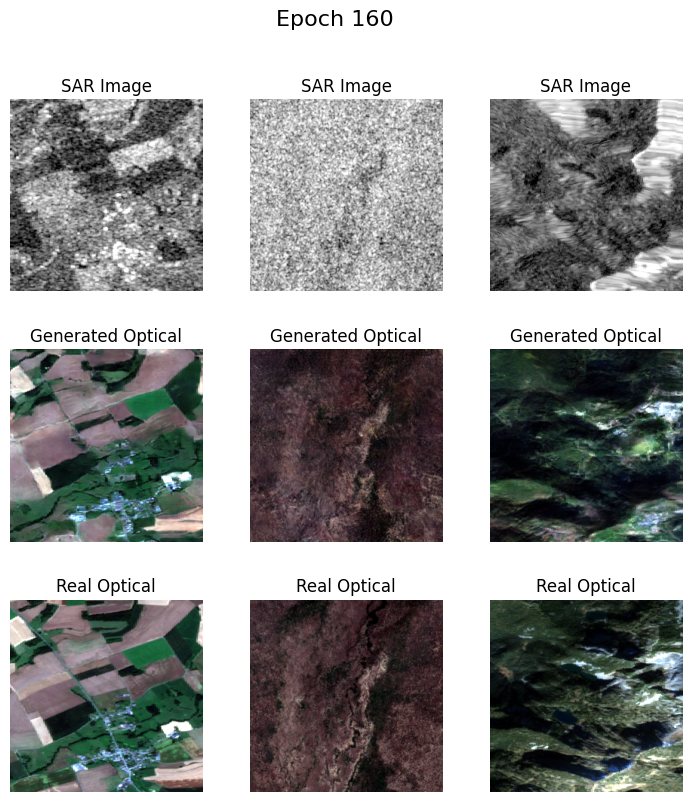

Checkpoint saved at epoch 160


100%|██████████| 900/900 [00:52<00:00, 17.27it/s]


Epoch [161/200], Loss D: 0.259566992521286, Loss G: 18.50176239013672


100%|██████████| 900/900 [00:52<00:00, 17.27it/s]


Epoch [162/200], Loss D: 0.36135387420654297, Loss G: 16.203327178955078


100%|██████████| 900/900 [00:52<00:00, 17.27it/s]


Epoch [163/200], Loss D: 0.37149977684020996, Loss G: 15.861937522888184


100%|██████████| 900/900 [00:52<00:00, 17.28it/s]


Epoch [164/200], Loss D: 0.44461506605148315, Loss G: 15.859146118164062


100%|██████████| 900/900 [00:52<00:00, 17.28it/s]


Epoch [165/200], Loss D: 0.5455945730209351, Loss G: 18.11200523376465


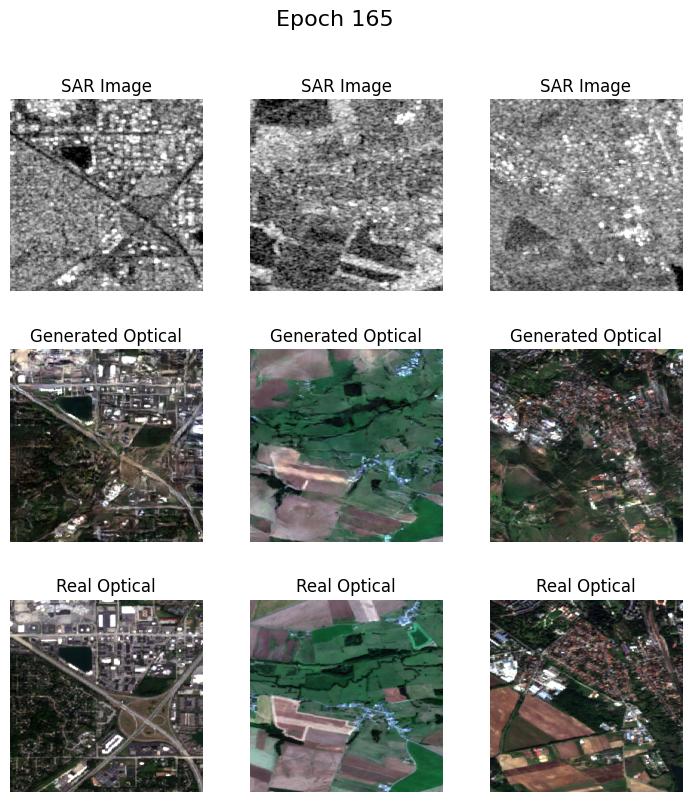

100%|██████████| 900/900 [00:52<00:00, 17.25it/s]


Epoch [166/200], Loss D: 0.14050230383872986, Loss G: 16.266773223876953


100%|██████████| 900/900 [00:52<00:00, 17.25it/s]


Epoch [167/200], Loss D: 0.3204389214515686, Loss G: 17.244489669799805


100%|██████████| 900/900 [00:52<00:00, 17.25it/s]


Epoch [168/200], Loss D: 0.30229514837265015, Loss G: 18.589691162109375


100%|██████████| 900/900 [00:52<00:00, 17.27it/s]


Epoch [169/200], Loss D: 0.5530923008918762, Loss G: 15.041833877563477


100%|██████████| 900/900 [00:52<00:00, 17.26it/s]


Epoch [170/200], Loss D: 0.2691153883934021, Loss G: 16.944969177246094


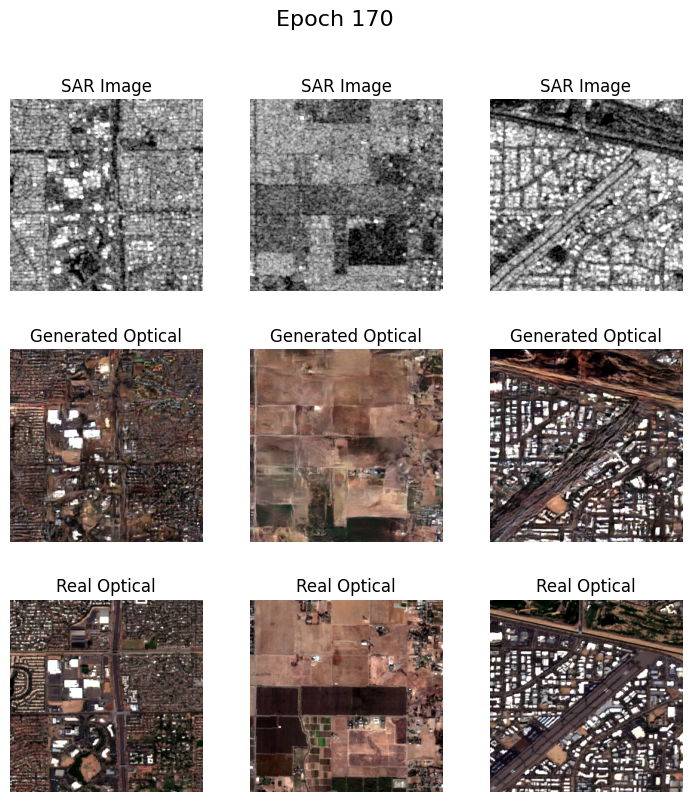

Checkpoint saved at epoch 170


100%|██████████| 900/900 [00:52<00:00, 17.26it/s]


Epoch [171/200], Loss D: 0.19990622997283936, Loss G: 18.343175888061523


100%|██████████| 900/900 [00:52<00:00, 17.26it/s]


Epoch [172/200], Loss D: 0.23454895615577698, Loss G: 15.97848892211914


100%|██████████| 900/900 [00:52<00:00, 17.24it/s]


Epoch [173/200], Loss D: 0.47114598751068115, Loss G: 16.008174896240234


100%|██████████| 900/900 [00:52<00:00, 17.25it/s]


Epoch [174/200], Loss D: 0.37700000405311584, Loss G: 17.08161735534668


100%|██████████| 900/900 [00:52<00:00, 17.25it/s]


Epoch [175/200], Loss D: 0.3991972804069519, Loss G: 17.67831039428711


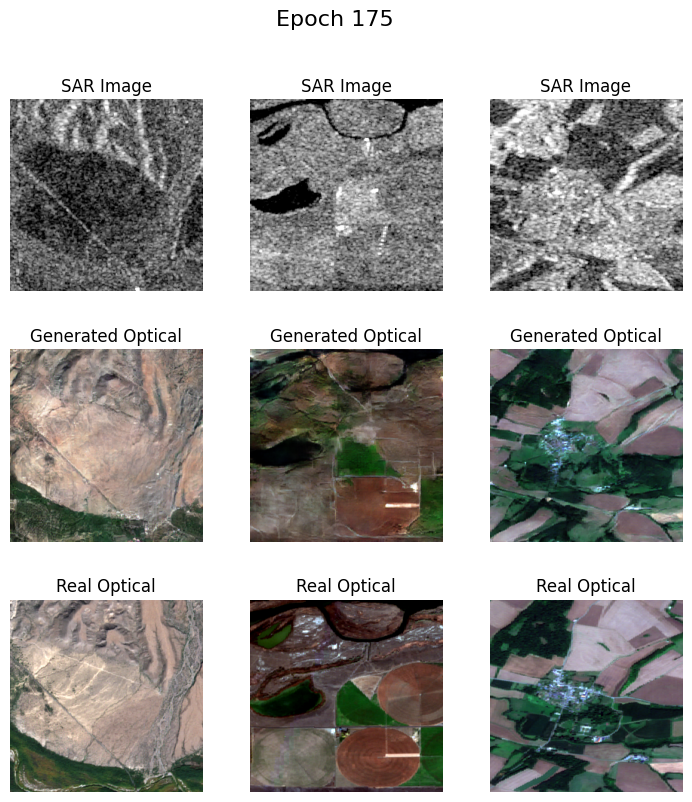

100%|██████████| 900/900 [00:52<00:00, 17.25it/s]


Epoch [176/200], Loss D: 0.4035152792930603, Loss G: 14.900227546691895


100%|██████████| 900/900 [00:52<00:00, 17.23it/s]


Epoch [177/200], Loss D: 0.28003573417663574, Loss G: 16.141008377075195


100%|██████████| 900/900 [00:52<00:00, 17.25it/s]


Epoch [178/200], Loss D: 0.21527819335460663, Loss G: 17.820175170898438


100%|██████████| 900/900 [00:52<00:00, 17.25it/s]


Epoch [179/200], Loss D: 0.5583411455154419, Loss G: 16.576059341430664


100%|██████████| 900/900 [00:52<00:00, 17.24it/s]


Epoch [180/200], Loss D: 0.326074481010437, Loss G: 15.538053512573242


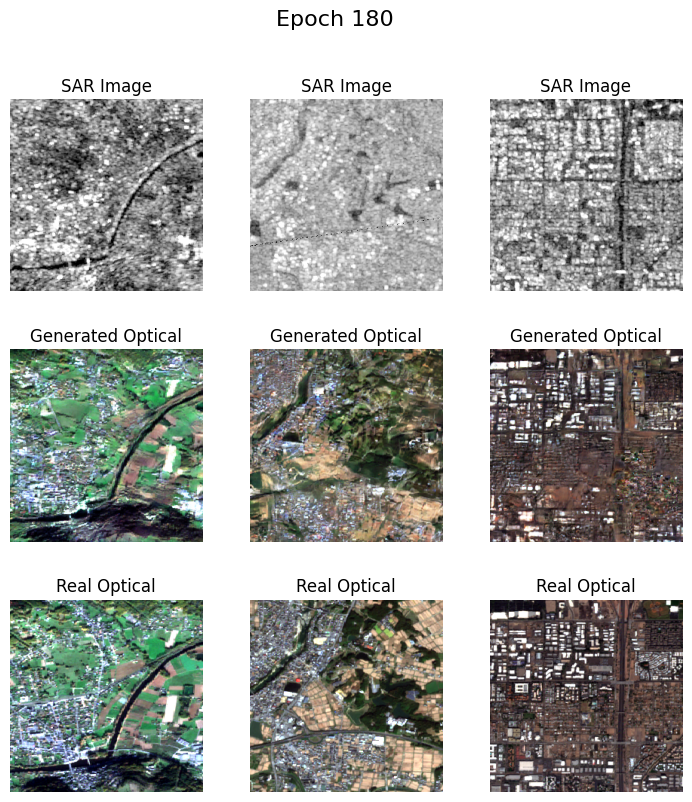

Checkpoint saved at epoch 180


100%|██████████| 900/900 [00:52<00:00, 17.27it/s]


Epoch [181/200], Loss D: 0.2943669855594635, Loss G: 16.136999130249023


100%|██████████| 900/900 [00:52<00:00, 17.28it/s]


Epoch [182/200], Loss D: 0.23704054951667786, Loss G: 17.85279655456543


100%|██████████| 900/900 [00:52<00:00, 17.26it/s]


Epoch [183/200], Loss D: 0.3192799985408783, Loss G: 16.167469024658203


100%|██████████| 900/900 [00:52<00:00, 17.26it/s]


Epoch [184/200], Loss D: 0.42905235290527344, Loss G: 16.960163116455078


100%|██████████| 900/900 [00:52<00:00, 17.27it/s]


Epoch [185/200], Loss D: 0.3943747878074646, Loss G: 15.497499465942383


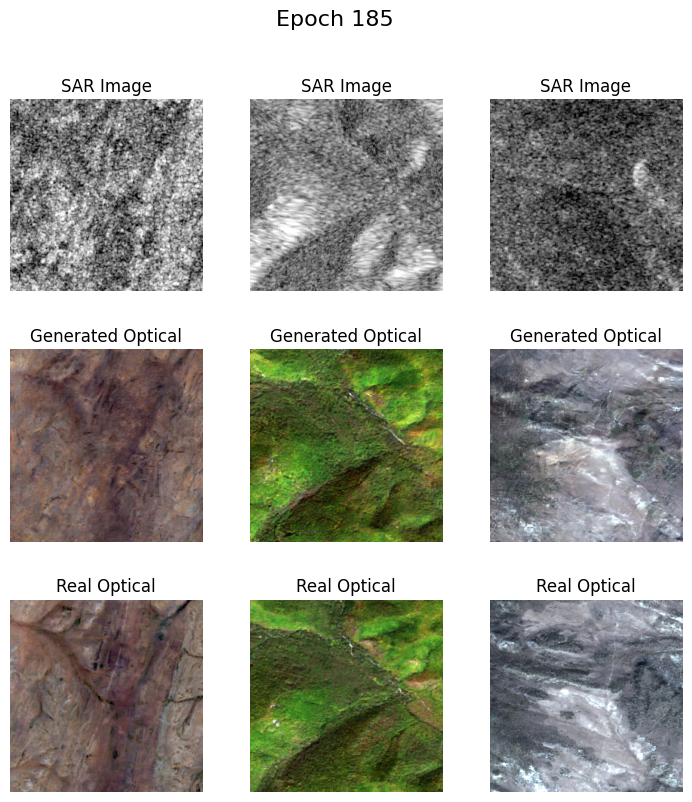

100%|██████████| 900/900 [00:52<00:00, 17.25it/s]


Epoch [186/200], Loss D: 0.1673954278230667, Loss G: 17.778404235839844


100%|██████████| 900/900 [00:52<00:00, 17.24it/s]


Epoch [187/200], Loss D: 0.42921626567840576, Loss G: 16.97482681274414


100%|██████████| 900/900 [00:52<00:00, 17.26it/s]


Epoch [188/200], Loss D: 0.3901576101779938, Loss G: 14.988188743591309


100%|██████████| 900/900 [00:52<00:00, 17.24it/s]


Epoch [189/200], Loss D: 0.24457572400569916, Loss G: 14.919992446899414


100%|██████████| 900/900 [00:52<00:00, 17.25it/s]


Epoch [190/200], Loss D: 0.22482788562774658, Loss G: 16.82254409790039


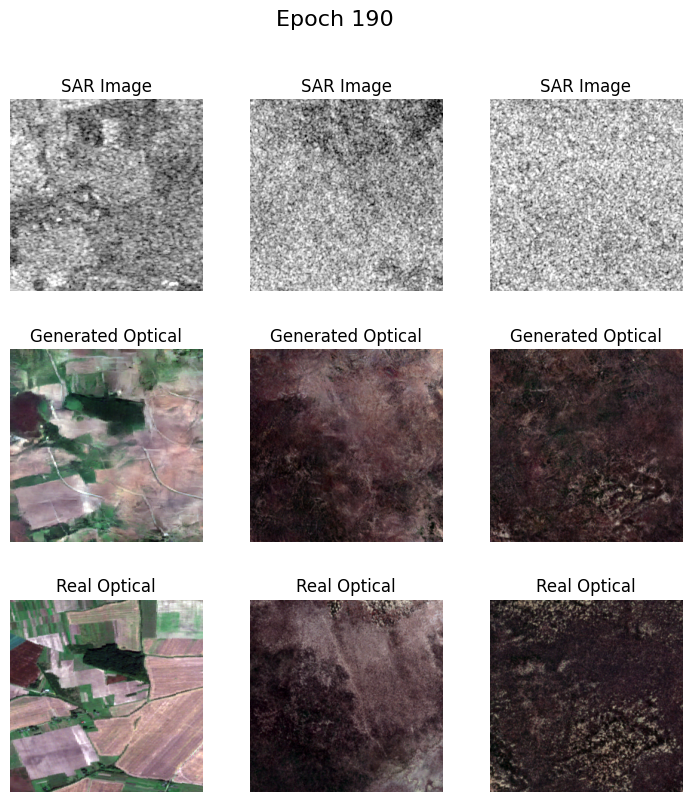

Checkpoint saved at epoch 190


100%|██████████| 900/900 [00:52<00:00, 17.27it/s]


Epoch [191/200], Loss D: 0.20012730360031128, Loss G: 17.656246185302734


100%|██████████| 900/900 [00:52<00:00, 17.26it/s]


Epoch [192/200], Loss D: 0.6319032907485962, Loss G: 18.765478134155273


100%|██████████| 900/900 [00:52<00:00, 17.27it/s]


Epoch [193/200], Loss D: 0.16294661164283752, Loss G: 19.154891967773438


100%|██████████| 900/900 [00:52<00:00, 17.25it/s]


Epoch [194/200], Loss D: 0.19029463827610016, Loss G: 16.244352340698242


100%|██████████| 900/900 [00:52<00:00, 17.24it/s]


Epoch [195/200], Loss D: 0.5141822695732117, Loss G: 17.72749137878418


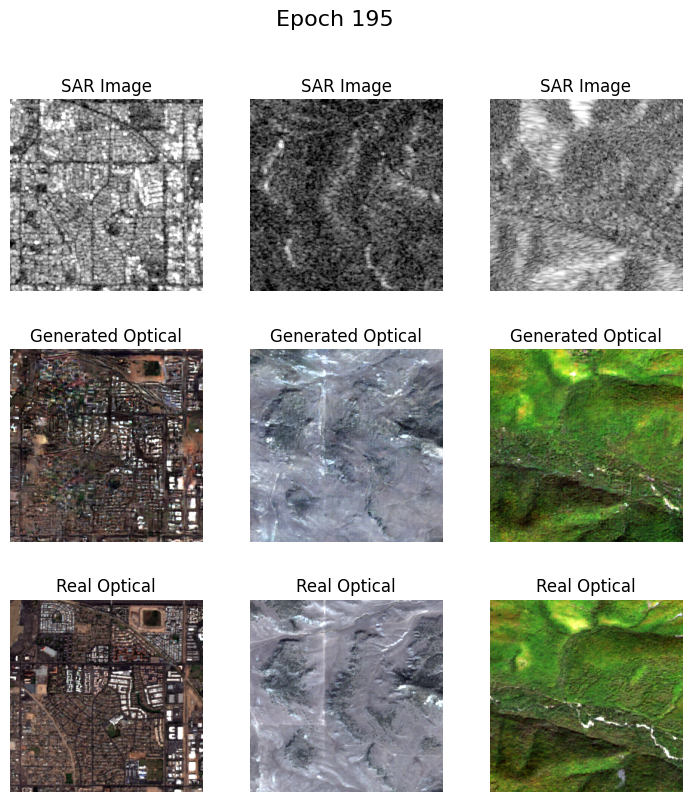

100%|██████████| 900/900 [00:52<00:00, 17.26it/s]


Epoch [196/200], Loss D: 14.014802932739258, Loss G: 18.77684211730957


100%|██████████| 900/900 [00:52<00:00, 17.22it/s]


Epoch [197/200], Loss D: 0.15383493900299072, Loss G: 15.919485092163086


100%|██████████| 900/900 [00:52<00:00, 17.26it/s]


Epoch [198/200], Loss D: 0.9856694936752319, Loss G: 15.20796012878418


100%|██████████| 900/900 [00:52<00:00, 17.25it/s]


Epoch [199/200], Loss D: 0.21770398318767548, Loss G: 18.130319595336914


100%|██████████| 900/900 [00:52<00:00, 17.24it/s]


Epoch [200/200], Loss D: 0.7508887648582458, Loss G: 16.002853393554688


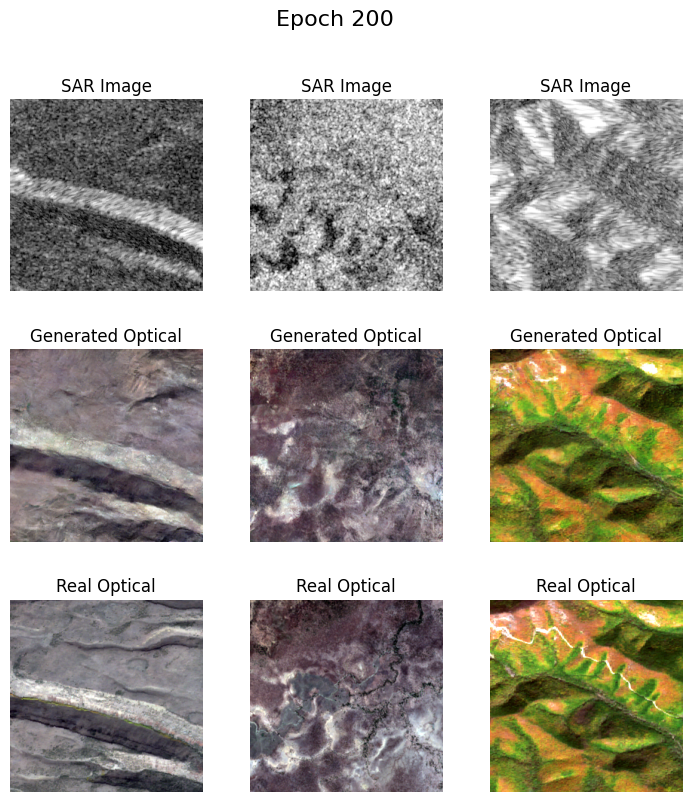

Checkpoint saved at epoch 200


In [ ]:

fit(
    generator=generator,
    discriminator=discriminator,
    train_loader=train_loader,
    test_loader=test_loader,
    optimizer_G=optimizer_G,
    optimizer_D=optimizer_D,
    criterion_GAN=criterion_GAN,
    criterion_L1=criterion_L1,
    device=device,
    start_epoch=0,
    num_epochs=200,
    save_freq=10,  # 10 epochs
    plot_freq=5    # 5 epochs
)

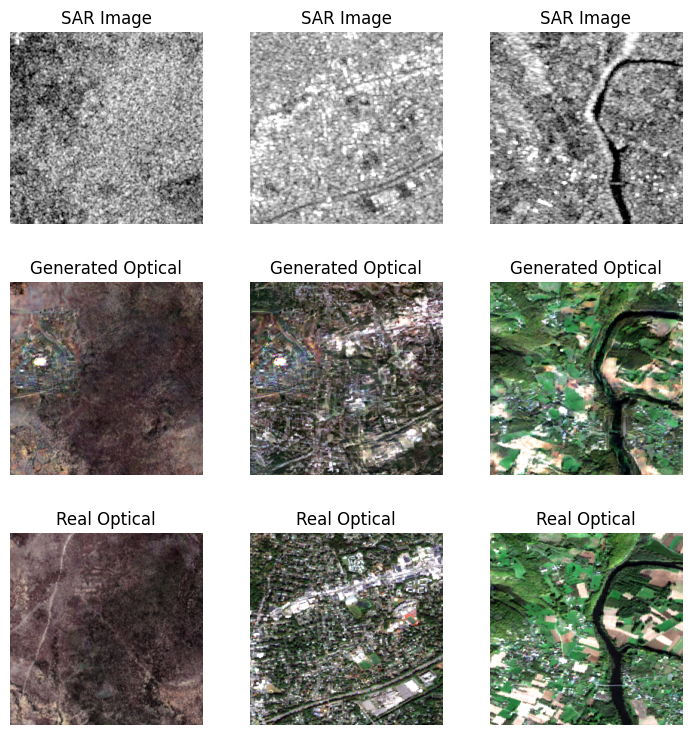

In [42]:
plot_images(
    generator=generator,
    test_loader=test_loader,
    device=device,
    epoch=None  # No epoch number in the title
)

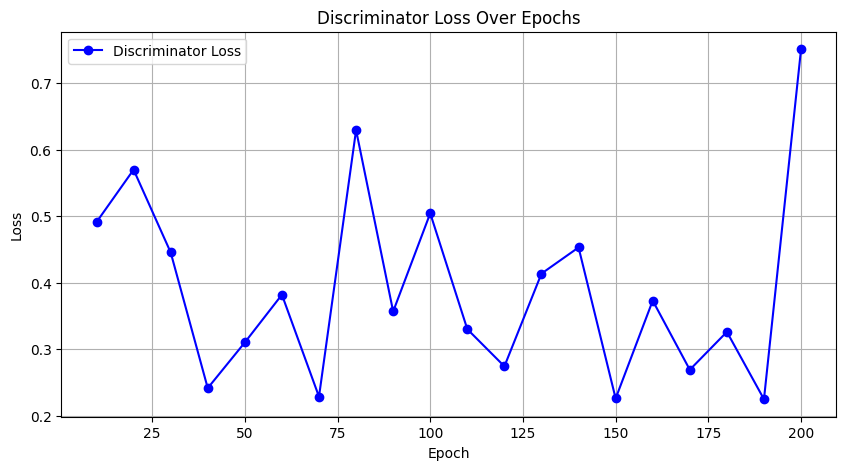

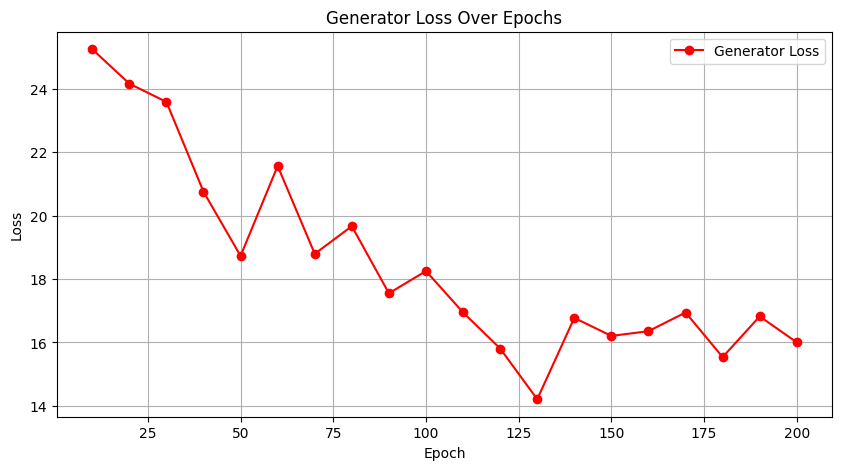

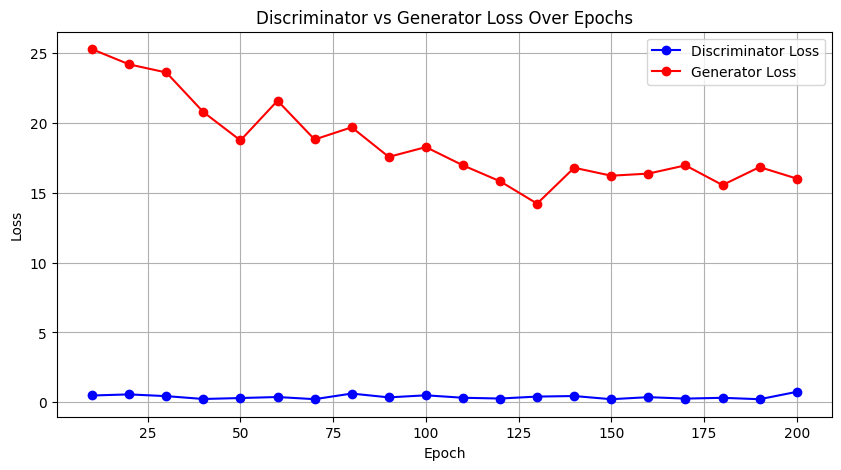

In [ ]:
import torch
import matplotlib.pyplot as plt

epochs = []
loss_D_list = []
loss_G_list = []

for epoch in range(10, 201, 10):
    checkpoint_path = f"checkpoint_epoch_{epoch}.pth" 
    checkpoint = torch.load(checkpoint_path)  

    epochs.append(epoch)
    loss_D_list.append(checkpoint['loss_D'].item())  
    loss_G_list.append(checkpoint['loss_G'].item())  

plt.figure(figsize=(10, 5))
plt.plot(epochs, loss_D_list, label="Discriminator Loss", color='blue', marker='o')
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title("Discriminator Loss Over Epochs")
plt.legend()
plt.grid()
plt.show()


plt.figure(figsize=(10, 5))
plt.plot(epochs, loss_G_list, label="Generator Loss", color='red', marker='o')
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title("Generator Loss Over Epochs")
plt.legend()
plt.grid()
plt.show()

plt.figure(figsize=(10, 5))
plt.plot(epochs, loss_D_list, label="Discriminator Loss", color='blue', marker='o')
plt.plot(epochs, loss_G_list, label="Generator Loss", color='red', marker='o')
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title("Discriminator vs Generator Loss Over Epochs")
plt.legend()
plt.grid()
plt.show()

In [19]:
check_path = "/content/checkpoint_epoch_200.pth"
checkpoint = torch.load(check_path)

In [20]:
print(checkpoint.keys())

dict_keys(['epoch', 'generator_state_dict', 'discriminator_state_dict', 'optimizer_G_state_dict', 'optimizer_D_state_dict', 'loss_D', 'loss_G'])


In [ ]:
import torch
import numpy as np
from skimage.metrics import structural_similarity as ssim
from skimage.metrics import peak_signal_noise_ratio as psnr
from torchvision.utils import save_image
import os
from pytorch_fid import fid_score

generator.eval()


fake_images = []
target_images = []

with torch.no_grad():
    for input_images, target in test_loader:
        input_images = input_images.to(device)
        target = target.to(device)

        fake = generator(input_images)

        fake_images.append(fake.cpu())
        target_images.append(target.cpu())


fake_images = torch.cat(fake_images, dim=0)
target_images = torch.cat(target_images, dim=0)

fake_images_np = fake_images.numpy()
target_images_np = target_images.numpy()

#  SSIM and PSNR
ssim_values = []
psnr_values = []
for i in range(fake_images_np.shape[0]):
    ssim_values.append(ssim(fake_images_np[i], target_images_np[i], channel_axis=0, data_range=1.0))  
    psnr_values.append(psnr(target_images_np[i], fake_images_np[i], data_range=1.0))


mean_ssim = np.mean(ssim_values)
mean_psnr = np.mean(psnr_values)

print(f"Mean SSIM: {mean_ssim}")
print(f"Mean PSNR: {mean_psnr}")


def save_images(images, save_dir):
    os.makedirs(save_dir, exist_ok=True)
    for i, img in enumerate(images):
        save_image(img, os.path.join(save_dir, f"{i}.png"))


real_save_dir = "real_images"
fake_save_dir = "fake_images"
save_images(target_images, real_save_dir)
save_images(fake_images, fake_save_dir)

fid_value = fid_score.calculate_fid_given_paths([real_save_dir, fake_save_dir], batch_size=50, device='cuda', dims=2048)
print(f"FID: {fid_value}")

Mean SSIM: 0.25993043184280396
Mean PSNR: 13.355594100863883


Downloading: "https://github.com/mseitzer/pytorch-fid/releases/download/fid_weights/pt_inception-2015-12-05-6726825d.pth" to /root/.cache/torch/hub/checkpoints/pt_inception-2015-12-05-6726825d.pth
100%|██████████| 91.2M/91.2M [00:00<00:00, 433MB/s]
100%|██████████| 32/32 [00:04<00:00,  6.89it/s]


FID: 54.75366702324146


In [ ]:

torch.save(generator, "generator_full.pth")
torch.save(discriminator, "discriminator_full.pth")
print("Full generator and discriminator models saved.")

Full generator and discriminator models saved.
